In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/customer_support_tickets.csv
/kaggle/input/WA_Fn-UseC_-Telco-Customer-Churn.csv
/kaggle/input/CDR-Call-Details.csv


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('ggplot')
# pd.set_option('max_columns', 100)

# EDA 

#### Don't forget to change the dataset path when loading it in (read_csv() function's argument)

In [3]:
df = pd.read_csv('/kaggle/input/CDR-Call-Details.csv') 

## Understanding the data

In [4]:
df.shape

(101174, 17)

So there's 101174 rows, 17 columns/features

In [5]:
df.columns

Index(['Phone Number', 'Account Length', 'VMail Message', 'Day Mins',
       'Day Calls', 'Day Charge', 'Eve Mins', 'Eve Calls', 'Eve Charge',
       'Night Mins', 'Night Calls', 'Night Charge', 'Intl Mins', 'Intl Calls',
       'Intl Charge', 'CustServ Calls', 'Churn'],
      dtype='object')

There's 17 different columns

In [6]:
# replacing the spaces with underscores for code purposes i suppose
df.columns = df.columns.str.replace(' ', '_')

df.columns

Index(['Phone_Number', 'Account_Length', 'VMail_Message', 'Day_Mins',
       'Day_Calls', 'Day_Charge', 'Eve_Mins', 'Eve_Calls', 'Eve_Charge',
       'Night_Mins', 'Night_Calls', 'Night_Charge', 'Intl_Mins', 'Intl_Calls',
       'Intl_Charge', 'CustServ_Calls', 'Churn'],
      dtype='object')

In [7]:
df

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
0,382-4657,128,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,371-7191,107,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,358-1921,137,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,375-9999,84,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,330-6626,75,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101169,789-9756,222,0,228.2,60,22.82,229.8,289,28.26,222.8,222,2.28,6.2,2,2.62,2,False
101170,798-5885,88,0,282.2,222,82.88,208.8,220,22.82,282.2,200,20.68,9.8,8,2.82,8,False
101171,798-5798,22,0,222.2,62,88.66,228.0,228,22.08,62.2,209,2.26,2.8,6,2.22,2,False
101172,999-9897,228,0,222.0,99,88.08,220.2,80,22.92,282.9,28,20.22,2.2,8,0.82,0,False


In [8]:
#potential feature engg

# df['day_avg'] = df['Day Mins'] / df['Day Calls']
# df['day_avg']

In [9]:
df.head()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
0,382-4657,128,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,371-7191,107,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,358-1921,137,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,375-9999,84,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,330-6626,75,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [10]:
df.tail()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
101169,789-9756,222,0,228.2,60,22.82,229.8,289,28.26,222.8,222,2.28,6.2,2,2.62,2,False
101170,798-5885,88,0,282.2,222,82.88,208.8,220,22.82,282.2,200,20.68,9.8,8,2.82,8,False
101171,798-5798,22,0,222.2,62,88.66,228.0,228,22.08,62.2,209,2.26,2.8,6,2.22,2,False
101172,999-9897,228,0,222.0,99,88.08,220.2,80,22.92,282.9,28,20.22,2.2,8,0.82,0,False
101173,786-7589,228,0,226.2,98,86.28,288.2,208,28.28,800.0,228,28.80,20.0,8,2.20,2,False


Viewed the head and tail to get a look at the data present
## Assumptions
### assuming Account_Length is measured in days
### assuming charges are measured in USD ($)
(because there's no dataset discription provided)

In [11]:
print(df.info()) #objects are strings essentially

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101174 entries, 0 to 101173
Data columns (total 17 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Phone_Number    101174 non-null  object 
 1   Account_Length  101174 non-null  int64  
 2   VMail_Message   101174 non-null  int64  
 3   Day_Mins        101174 non-null  float64
 4   Day_Calls       101174 non-null  int64  
 5   Day_Charge      101174 non-null  float64
 6   Eve_Mins        101174 non-null  float64
 7   Eve_Calls       101174 non-null  int64  
 8   Eve_Charge      101174 non-null  float64
 9   Night_Mins      101174 non-null  float64
 10  Night_Calls     101174 non-null  int64  
 11  Night_Charge    101174 non-null  float64
 12  Intl_Mins       101174 non-null  float64
 13  Intl_Calls      101174 non-null  int64  
 14  Intl_Charge     101174 non-null  float64
 15  CustServ_Calls  101174 non-null  int64  
 16  Churn           101174 non-null  bool   
dtypes: bool(1)

There's 15 numbers - 8 float, 7 int columns then 1 bool and 1 object column as depicted above

In [12]:
print(df.describe())

       Account_Length  VMail_Message       Day_Mins      Day_Calls  \
count   101174.000000  101174.000000  101174.000000  101174.000000   
mean       323.597149      18.142645     587.080798     267.207613   
std       1418.073651      75.826932    2193.094319     947.963370   
min          1.000000       0.000000       0.000000       0.000000   
25%         69.000000       0.000000     222.300000      88.000000   
50%        202.000000       0.000000     262.200000     202.000000   
75%        240.000000      22.000000     326.275000     224.000000   
max      21111.000000    1111.000000  111111.110000   21111.000000   

          Day_Charge       Eve_Mins      Eve_Calls     Eve_Charge  \
count  101174.000000  101174.000000  101174.000000  101174.000000   
mean       64.958811     655.512526     267.166930      34.358125   
std       133.515808    2473.445436     932.914437      36.248577   
min         0.000000       0.000000       0.000000       0.000000   
25%        23.920000    

#### Inference
- Account_Length has a mix value of 21111 which is highly unlikely (21111 / 365 = 57 ish years which is highly unlikely)
- Similar to account length other fearues also have questionable maximum values indicating clear presence of outliers skewing the dataset essentially
- Every column has mean << 75th percentile so it's very much right skewed
- Higher values of std suggest wider range of values
- Vmail & CustServ features & Intl(mins, call, charge) features aside rest needs to be addressed of outliers because of impossible values
- 50th percentile 

In [13]:
#specifying the numeric columns
numeric_cols = ['Account_Length','Day_Mins','Day_Calls','Day_Charge', 'Eve_Mins', 'Eve_Calls','Eve_Charge', 'Night_Mins','Night_Calls','Night_Charge','Intl_Mins','Intl_Calls','Intl_Charge', 'VMail_Message']


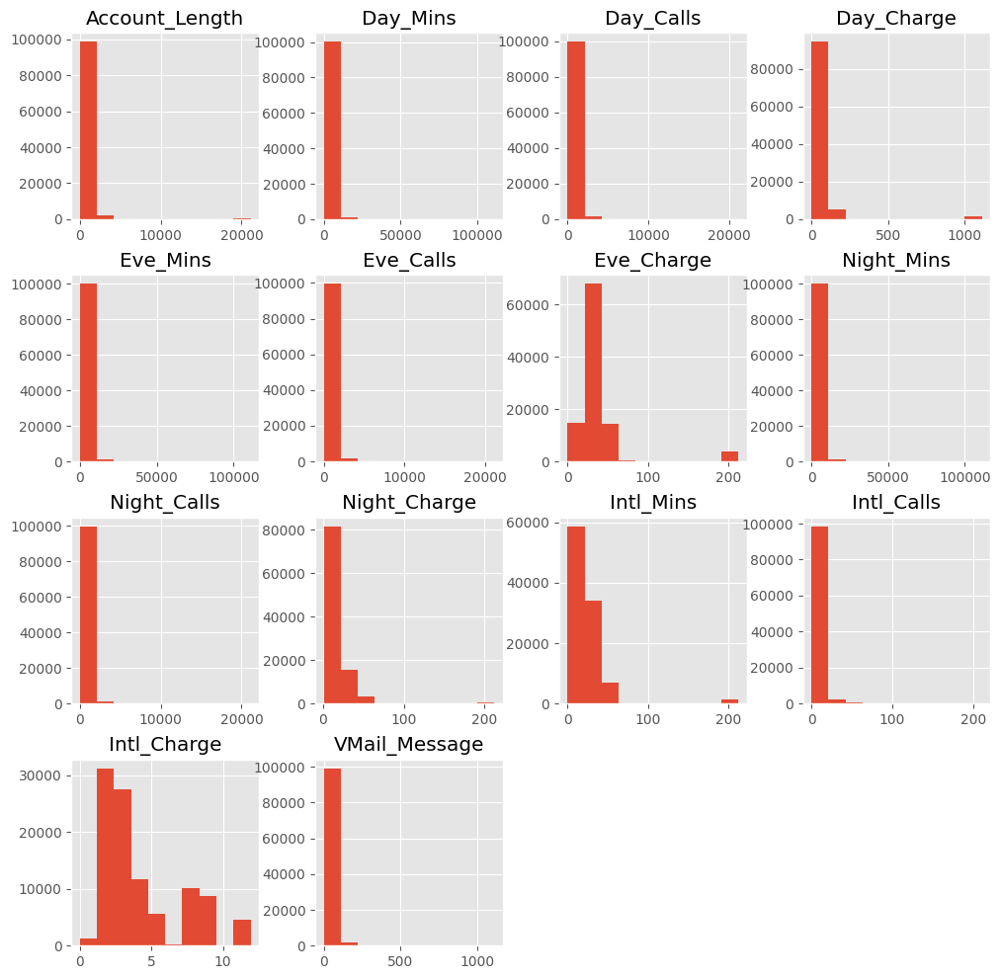

In [14]:
# histograms
df[numeric_cols].hist(figsize=(12, 12))
plt.show()

- histogram clearly indicating skewness 

### dropping the churn column

In [15]:
# df = df.drop(['Churn'], axis=1).copy()

- From what I've seen account_length seems to indicate the duration the account was open so given the stat summary of it I assume it is measured in days which validates the presence of other features 

## Null & NaN

In [16]:
print(df.isna().sum())

Phone_Number      0
Account_Length    0
VMail_Message     0
Day_Mins          0
Day_Calls         0
Day_Charge        0
Eve_Mins          0
Eve_Calls         0
Eve_Charge        0
Night_Mins        0
Night_Calls       0
Night_Charge      0
Intl_Mins         0
Intl_Calls        0
Intl_Charge       0
CustServ_Calls    0
Churn             0
dtype: int64


## Duplicates

In [17]:
df.duplicated().sum()

40729

- around 40k rows are duplicates 

- df.duplicated() without mentioning any specific features will compare all the features values for exact match essentially looking for 1-1 copy

In [18]:
df.loc[df.duplicated()]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
9999,785-9657,228,28,268.2,220,28.02,292.2,99,26.28,222.2,92,22.02,20.0,8,2.20,2,False
10000,779-7999,202,26,262.6,228,22.22,298.8,208,26.62,282.2,208,22.28,28.2,8,8.20,2,False
10001,758-9959,282,0,228.2,222,22.88,222.2,220,20.80,262.6,202,2.82,22.2,8,8.29,0,False
10002,775-9999,82,0,299.2,22,80.90,62.9,88,8.26,296.9,89,8.86,6.6,2,2.28,2,False
10003,778-6656,28,0,266.2,228,28.82,228.8,222,22.62,286.9,222,8.22,20.2,8,2.28,8,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99985,775-9988,292,86,286.2,22,26.88,228.8,226,28.82,229.2,88,22.86,9.9,6,2.62,2,False
99986,757-7869,68,0,282.2,82,89.29,288.2,88,28.02,292.8,228,8.62,9.6,2,2.89,8,False
99987,797-5759,28,0,280.8,209,80.22,288.8,88,22.88,292.9,92,8.62,22.2,6,8.82,2,False
99988,765-9799,282,0,228.8,208,86.88,289.6,82,28.82,289.2,282,6.26,8.0,20,2.88,2,False


In [19]:
df.query('Phone_Number == "779-7999"').head()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
3334,779-7999,407,46,464.6,445,47.47,495.5,405,46.64,454.4,405,44.45,45.7,5,5.7,4,False
6667,779-7999,202,26,262.6,228,22.22,298.8,208,26.62,282.2,208,22.28,28.2,8,8.2,2,False
10000,779-7999,202,26,262.6,228,22.22,298.8,208,26.62,282.2,208,22.28,28.2,8,8.2,2,False
13333,779-7999,202,26,262.6,228,22.22,298.8,208,26.62,282.2,208,22.28,28.2,8,8.2,2,False
16666,779-7999,202,26,262.6,228,22.22,298.8,208,26.62,282.2,208,22.28,28.2,8,8.2,2,False


- Making sure there's indeed outliers by manually quering and yes there's indeed duplicates

In [20]:
df = df.loc[~df.duplicated()].reset_index(drop=True).copy()
df

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
0,382-4657,128,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,371-7191,107,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,358-1921,137,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,375-9999,84,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,330-6626,75,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60440,789-9756,222,0,228.2,60,22.82,229.8,289,28.26,222.8,222,2.28,6.2,2,2.62,2,False
60441,798-5885,88,0,282.2,222,82.88,208.8,220,22.82,282.2,200,20.68,9.8,8,2.82,8,False
60442,798-5798,22,0,222.2,62,88.66,228.0,228,22.08,62.2,209,2.26,2.8,6,2.22,2,False
60443,999-9897,228,0,222.0,99,88.08,220.2,80,22.92,282.9,28,20.22,2.2,8,0.82,0,False


- Removed the duplicates which dropped the total rows from 100k to 60k (approx values), so as mentioned earlier 40k rows are duplicates

### unique counts in a feature

In [21]:
df.nunique()

Phone_Number      7467
Account_Length     322
VMail_Message       72
Day_Mins          2548
Day_Calls          221
Day_Charge        2873
Eve_Mins          2523
Eve_Calls          224
Eve_Charge        2221
Night_Mins        2464
Night_Calls        218
Night_Charge      1470
Intl_Mins          267
Intl_Calls          39
Intl_Charge        339
CustServ_Calls      11
Churn                2
dtype: int64

- Checking for unique counts in hopes of finding anything unusual

In [22]:
df.shape

(60445, 17)

- Confirming shape once again

## Outliers

In [23]:
df.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls
count,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000,60445.000000
mean,329.385541,18.101613,596.555649,274.752138,64.880486,669.288486,272.647911,34.894168,661.395415,267.133377,14.066812,20.571371,5.728894,4.315376,2.563438
std,1436.763064,76.859936,2231.437206,997.047766,134.695269,2476.768325,956.454815,36.584588,2422.994289,913.240573,16.532483,25.494288,8.271802,2.711543,2.376449
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.300000,20.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,68.000000,0.000000,222.200000,88.000000,24.220000,223.400000,88.000000,22.220000,223.200000,88.000000,6.220000,8.800000,2.000000,2.280000,2.000000
50%,200.000000,0.000000,262.200000,202.000000,32.920000,268.800000,200.000000,24.900000,269.110000,200.000000,9.220000,20.200000,4.000000,2.920000,2.000000
75%,243.000000,22.000000,404.400000,226.000000,80.480000,440.400000,226.000000,32.620000,440.400000,226.000000,20.400000,22.800000,8.000000,4.940000,4.000000
max,21111.000000,1111.000000,111111.110000,21111.000000,1111.990000,111111.200000,21111.000000,211.990000,111111.110000,21111.000000,211.920000,211.900000,211.000000,11.920000,11.000000


#### After removing duplicates and before addressing/removing outliers checking stat summary once more

- mean > 75th percentile so large valued outliers pulling the mean up while majority is on the lower side?
- meadian[50th percentile] 0 for Vmail suggesting majority of customers don't use it at all, so no need to include that for outlier removal



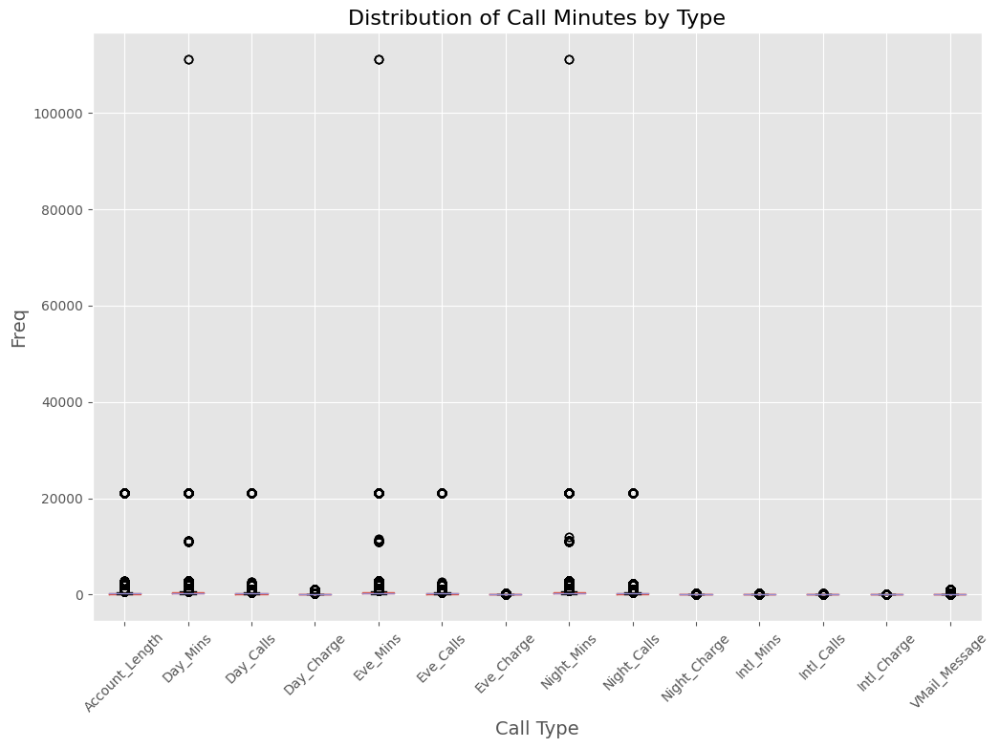

In [24]:
fig, ax = plt.subplots(figsize=(12, 8))

# boxplot (all in one)
df.boxplot(column= numeric_cols,
           ax=ax)

# labellingg
ax.set_title('Distribution of Call Minutes by Type', fontsize=16)
ax.set_xlabel('Call Type', fontsize=14)
ax.set_ylabel('Freq', fontsize=14)
ax.set_xticklabels(numeric_cols, rotation=45)

plt.show()

#### By visualizing through box plot we are able to clearly identify outliers

In [25]:
df[df['Account_Length'] > 10000]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
18153,777-9685,21111,22,2211.20,1111,29.2110,2011.90,202,22.1111,222.20,211,11.1100,22.60,211,11.920,0,True
18182,987-6577,21111,0,222.11,911,22.2200,220.11,1111,22.2900,2911.11,202,211.2900,22.11,2,11.290,11,False
18203,985-5887,21111,0,2011.20,200,112.1111,290.90,202,26.2110,296.00,229,11.1120,11.90,2,2.200,0,True
18214,755-5578,21111,0,2112.20,112,211.2900,229.00,2011,20.2200,2110.00,200,11.2000,20.11,6,2.112,0,False
18278,786-5957,21111,112,2119.11,226,112.2200,2611.11,21111,211.1111,262.11,226,22.9200,2.11,11,2.011,2,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26096,987-9958,21111,0,222.20,2211,22.1100,229.11,611,22.2110,222.20,112,9.1120,211.60,11,11.620,2,False
26157,989-7887,21111,0,290.00,200,112.1100,226.60,211,20.9600,1102.20,202,211.6900,9.11,2,2.112,2,False
26200,789-7997,21111,0,2116.20,62,211.6110,2112.20,60,211.9200,226.20,222,6.1111,22.00,2,2.920,2,True
26204,768-9758,21111,1111,21111.20,2119,26.1111,2611.11,29,22.1120,2116.20,22,11.1190,9.20,2,2.620,11,False


In [26]:
df[df['Account_Length'] > 10000].nunique()

Phone_Number      267
Account_Length      1
VMail_Message      10
Day_Mins           59
Day_Calls          25
Day_Charge         70
Eve_Mins           61
Eve_Calls          28
Eve_Charge         60
Night_Mins         57
Night_Calls        27
Night_Charge       73
Intl_Mins          29
Intl_Calls          8
Intl_Charge        31
CustServ_Calls      3
Churn               2
dtype: int64

- only 200 rows having account length greater then 10k which is all the same value(it has only 1 unique value) from the looks of it [21111]

- could've done a more nuanced outlier detection by doing feature engineering but not sure what features to create so we shall not do that

In [27]:
df[(df['Day_Mins'] > 20000)]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
18121,978-5875,222,112,21111.60,112,211.9600,222.00,222,211.112,1126.20,92,22.690,22.20,11,11.0200,0,False
18132,767-7969,222,0,21111.20,222,26.1120,2119.20,911,20.112,2011.11,21111,9.200,20.60,2,2.1160,0,False
18134,765-7787,2110,0,21111.00,222,112.2200,22.90,99,6.200,2112.11,211,11.211,9.11,29,2.1120,0,False
18161,757-7858,92,22,21111.20,21111,22.6200,222.20,1111,211.260,20.60,29,11.211,22.00,11,2.9200,2,False
18186,777-7977,1111,0,21111.11,209,20.0900,2112.20,92,211.116,21111.20,99,11.220,22.00,11,11.2200,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26191,988-5689,222,0,21111.20,911,211.1120,266.90,92,22.690,292.20,2211,11.900,11.11,11,2.1111,11,True
26204,768-9758,21111,1111,21111.20,2119,26.1111,2611.11,29,22.112,2116.20,22,11.119,9.20,2,2.6200,11,False
26211,999-5977,112,0,21111.00,92,20.2600,262.11,92,211.911,2112.11,2112,22.220,20.60,6,2.1160,2,False
26214,757-8595,99,0,21111.20,96,20.1111,226.11,2110,20.911,2911.20,222,11.911,22.20,2,11.1111,11,False


In [28]:
df[(df['Day_Mins'] > 20000)]['Day_Mins'].nunique()

6

In [29]:
df[(df['Eve_Mins'] > 20000)]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
18139,797-7558,112,0,2112.11,211,22.1111,21111.11,200,211.2200,202.20,611,2.1190,22.20,2,11.920,11,False
18140,797-6857,20,0,290.00,209,112.1100,21111.20,112,22.9110,2112.11,202,11.2200,6.11,6,2.200,0,False
18183,977-6857,262,26,222.90,92,1111.2110,21111.20,112,26.0000,2112.60,62,22.2600,22.20,2,11.220,0,False
18191,778-9769,20,0,220.20,911,211.9110,21111.20,202,211.2900,2211.60,26,20.2900,211.00,2,2.011,2,False
18198,985-7778,92,0,2112.90,2011,26.1120,21111.00,202,211.2110,2119.60,112,11.1111,11.00,11,2.260,2,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26227,989-6977,1111,22,222.20,222,1111.2000,21111.11,1111,20.1100,222.20,116,2.1120,22.11,2,11.220,2,False
26230,799-6777,119,0,2211.20,112,110.1111,21111.20,22,29.1160,2112.90,220,11.9200,9.20,2,2.260,2,False
26231,799-9859,2611,0,292.20,90,1111.1120,21111.11,2211,26.0200,222.20,92,9.1100,2.11,11,2.220,2,False
26237,959-9989,611,0,2112.20,112,119.2900,21111.20,1111,211.0200,292.11,2211,11.6200,9.60,2,2.119,11,False


In [30]:
df[(df['Eve_Mins'] > 20000)]['Eve_Mins'].nunique()

7

In [31]:
df[(df['Night_Mins'] > 20000)]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
18151,796-5567,229,0,220.20,92,211.112,222.11,92,211.200,21111.11,2011,11.220,22.20,9,11.000,2,False
18174,779-6759,22,1111,2911.20,92,112.911,226.20,96,20.920,21111.00,92,6.220,22.60,11,11.920,2,False
18180,796-7578,226,0,222.60,20,1111.920,226.90,110,211.220,21111.11,60,6.920,2.11,2,2.220,2,False
18186,777-7977,1111,0,21111.11,209,20.090,2112.20,92,211.116,21111.20,99,11.220,22.00,11,11.220,0,False
18204,795-7785,110,0,222.11,200,22.211,2211.00,202,22.220,21111.20,62,22.119,2.90,9,2.211,2,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26148,798-9775,220,0,292.60,2211,112.220,206.20,2011,22.112,21111.20,911,22.220,20.11,11,2.920,2,False
26156,755-5889,116,0,222.90,222,112.220,2211.20,222,211.611,21111.20,1111,22.960,2.20,11,2.920,0,True
26210,775-7999,2112,0,262.90,2211,211.011,226.11,96,20.211,21111.11,2211,20.211,20.00,9,2.200,2,False
26216,799-9898,206,110,220.20,2011,112.220,222.20,209,211.119,21111.20,96,2.211,211.20,11,11.112,0,False


In [32]:
df[(df['Night_Mins'] > 20000)]['Night_Mins'].nunique()

6

In [33]:
df[df['Day_Charge'] > 1000]

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
18128,976-7576,1111,22,296.20,2119,1111.119,2110.90,90,211.1111,119.11,211,2.020,211.11,2,11.2110,2,False
18131,798-6557,211,0,222.20,90,1111.211,2119.11,1111,211.1160,292.11,22,11.611,211.00,2,11.1120,2,False
18143,799-7889,211,0,226.20,2011,1111.220,202.11,202,22.2110,226.20,911,22.011,20.11,11,2.2110,2,False
18158,777-5986,611,0,222.11,220,1111.920,262.60,222,211.1120,2112.20,2211,6.060,211.20,11,11.1160,11,False
18169,789-6775,222,110,2911.20,229,1111.211,211.11,22,6.2000,2112.20,22,11.211,11.11,11,2.1120,11,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26167,755-9985,22,0,2211.11,62,1111.011,222.11,22,20.1120,2211.11,2116,20.020,22.11,11,11.1120,11,False
26198,787-9996,260,0,206.11,66,1111.020,222.20,209,20.2900,222.11,202,20.211,22.20,6,11.2600,0,False
26209,997-9758,222,22,222.20,222,1111.211,226.00,206,22.2200,222.20,911,20.116,11.11,2,2.1111,2,False
26227,989-6977,1111,22,222.20,222,1111.200,21111.11,1111,20.1100,222.20,116,2.112,22.11,2,11.2200,2,False


In [34]:
df[df['Day_Charge'] > 1000]['Day_Charge'].nunique()

25

In [35]:
df[df['VMail_Message'] > 1000]['VMail_Message'].nunique()

1

- even though the mins features might have extreme values those have single digit unique values indicating outliers (all those customers only seem to have the same 6 values repeating over so yeah it's best to include them for outlier removal)

- from seeing the above it is best to include day, eve & night mins features for outlier detection because it quite varies unless there's a way to pinpoint them out by means of a intuitive feature engineering?

In [36]:
def remove_outliers_iqr(df, column_name):
    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column_name] >= lower_bound) & (df[column_name] <= upper_bound)]
#     return df[(df[column_name] <= upper_bound)]


In [37]:
outlier_cols = ['Account_Length','Day_Mins','Day_Calls', 'Eve_Mins', 'Eve_Calls', 'Night_Mins','Night_Calls']
# Loop through each selected col/feature
for col in outlier_cols:
    df = remove_outliers_iqr(df, col)

# Resetting index after filtering else it'll be inconsistent!
df.reset_index(drop=True, inplace=True)


In [38]:
df.shape

(36077, 17)

- dropped 24k ish rows there

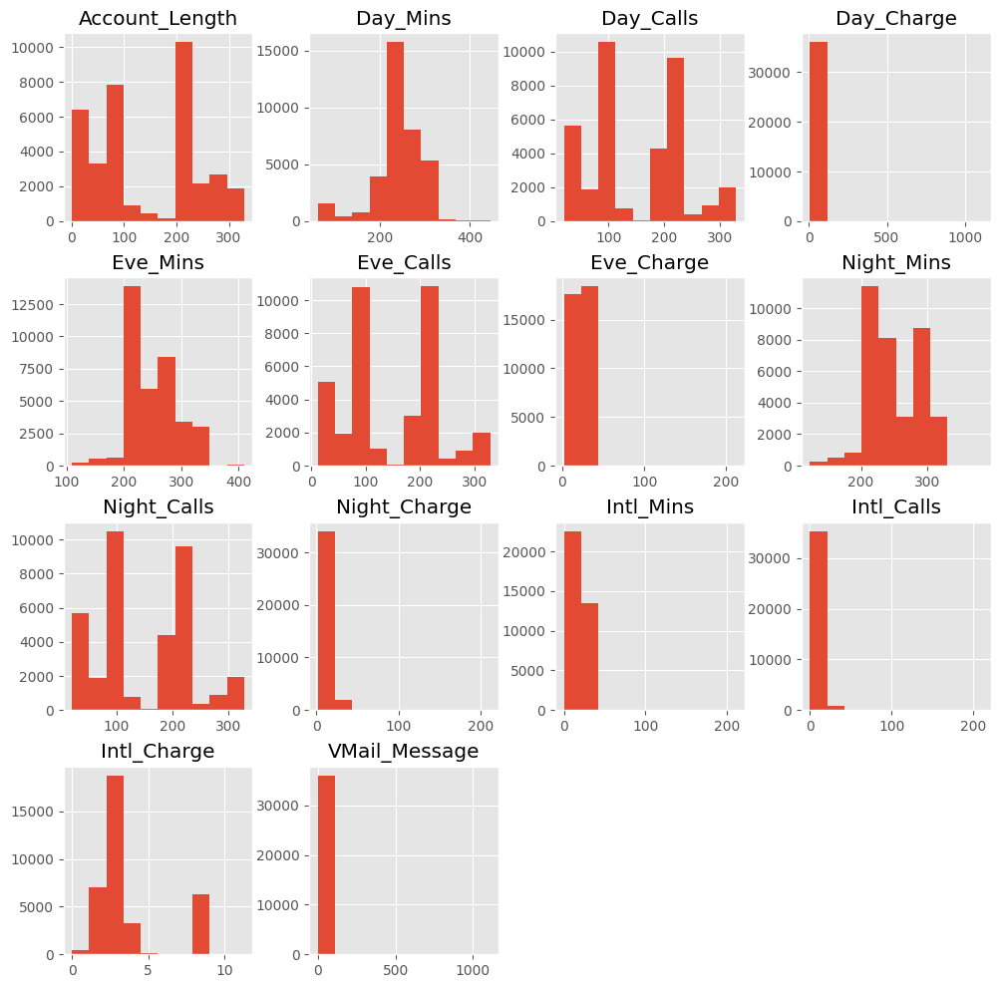

In [39]:
# histograms
df[numeric_cols].hist(figsize=(12, 12))
plt.show()

- After addressing some outliers the histogram looks not so skewed now

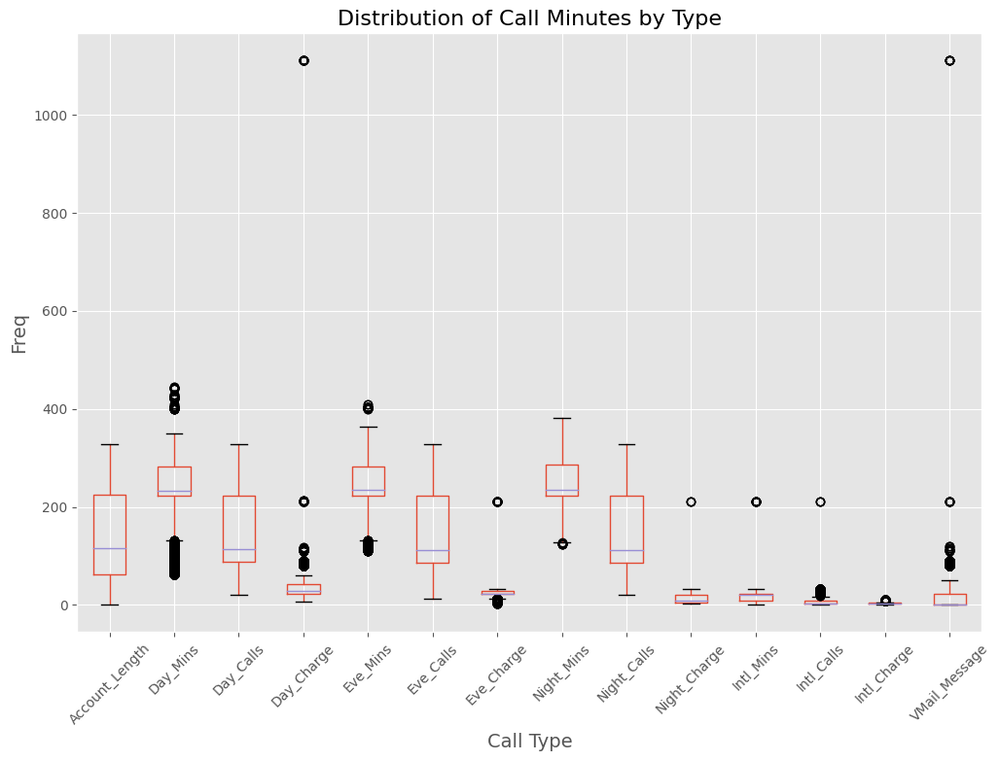

In [40]:
fig, ax = plt.subplots(figsize=(12, 8))

# box plot
df.boxplot(column=numeric_cols,
           ax=ax)

# titles and labels
ax.set_title('Distribution of Call Minutes by Type', fontsize=16)
ax.set_xlabel('Call Type', fontsize=14)
ax.set_ylabel('Freq', fontsize=14)
ax.set_xticklabels(numeric_cols, rotation=45)

plt.show()

- By means of another boxplot after removing extreme/impossible values we can get a more better viz

In [41]:
df = df[(df['Day_Charge'] < 1000) & (df['VMail_Message'] < 1000)]

In [42]:
df.shape

(36033, 17)

- from 60k rows to 36k rows after removing outliers, that's around 24k rows lost in outliers
- removed another 50ish rows by addressing the outliers in day_charege and vmail_message from previous box plot 

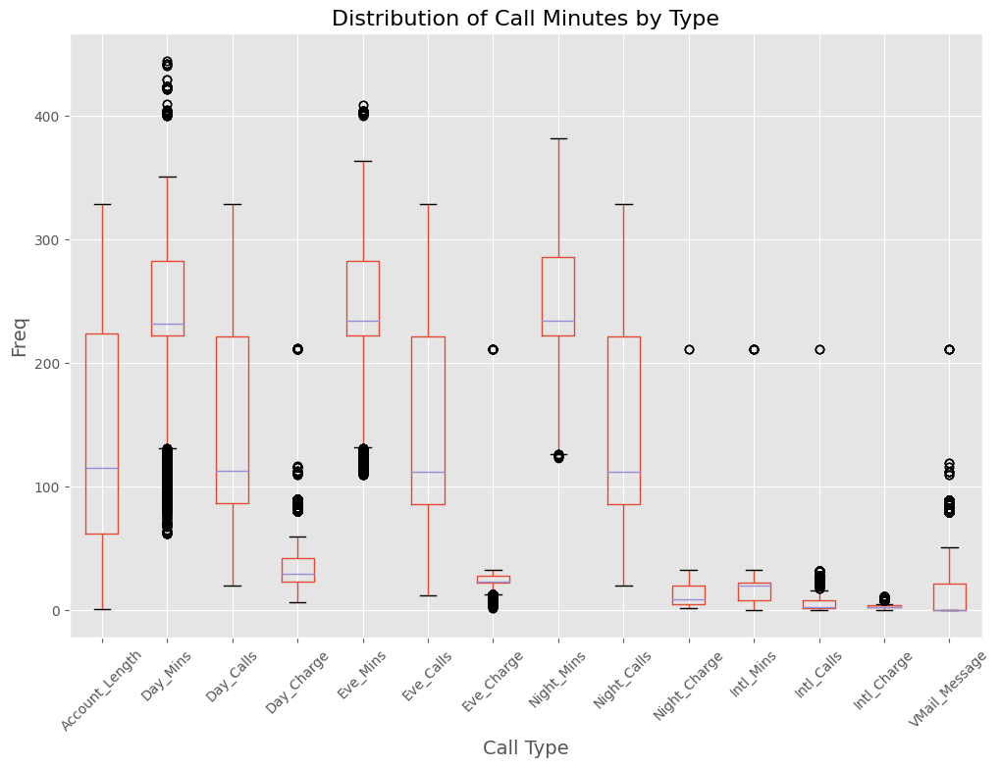

In [43]:
fig, ax = plt.subplots(figsize=(12, 8))

# box plot
df.boxplot(column=numeric_cols,
           ax=ax)

# titles and labels
ax.set_title('Distribution of Call Minutes by Type', fontsize=16)
ax.set_xlabel('Call Type', fontsize=14)
ax.set_ylabel('Freq', fontsize=14)
ax.set_xticklabels(numeric_cols, rotation=45)

plt.show()

- looks cleaned up now :)

#### Checking summary stats after removing outliers
-

In [44]:
df.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls
count,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000
mean,147.928205,11.216607,241.267724,149.078456,39.768770,249.978860,148.892904,24.370483,250.316727,148.205673,11.650730,15.632100,4.838315,3.703050,2.181084
std,96.566663,22.171680,53.103504,86.367865,24.035258,40.496675,86.248911,6.932231,39.543004,86.024933,8.339419,9.964079,4.686556,2.290302,2.014803
min,1.000000,0.000000,62.300000,20.000000,6.220000,109.600000,12.000000,2.110000,123.500000,20.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,62.000000,0.000000,222.200000,87.000000,23.230000,222.400000,86.000000,22.220000,222.400000,86.000000,4.920000,8.200000,2.000000,2.280000,2.000000
50%,115.000000,0.000000,232.200000,113.000000,29.240000,234.400000,112.000000,23.220000,234.400000,112.000000,9.200000,20.000000,3.000000,2.820000,2.000000
75%,224.000000,22.000000,282.800000,222.000000,42.420000,282.900000,222.000000,28.280000,286.200000,222.000000,20.290000,22.300000,8.000000,4.000000,2.000000
max,329.000000,211.000000,444.400000,329.000000,211.990000,409.200000,329.000000,211.260000,381.900000,329.000000,211.220000,211.200000,211.000000,11.290000,11.000000


In [45]:
df

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
0,382-4657,128,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,371-7191,107,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,358-1921,137,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,330-6626,75,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False
4,391-8027,118,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36072,796-5759,228,0,222.8,92,29.82,280.0,202,22.28,268.6,229,22.09,9.6,2,2.89,2,False
36073,779-7579,62,0,228.8,92,29.88,292.8,92,26.88,222.9,89,9.62,20.2,2,2.82,8,False
36074,789-9756,222,0,228.2,60,22.82,229.8,289,28.26,222.8,222,2.28,6.2,2,2.62,2,False
36075,798-5885,88,0,282.2,222,82.88,208.8,220,22.82,282.2,200,20.68,9.8,8,2.82,8,False


## Other visualizations

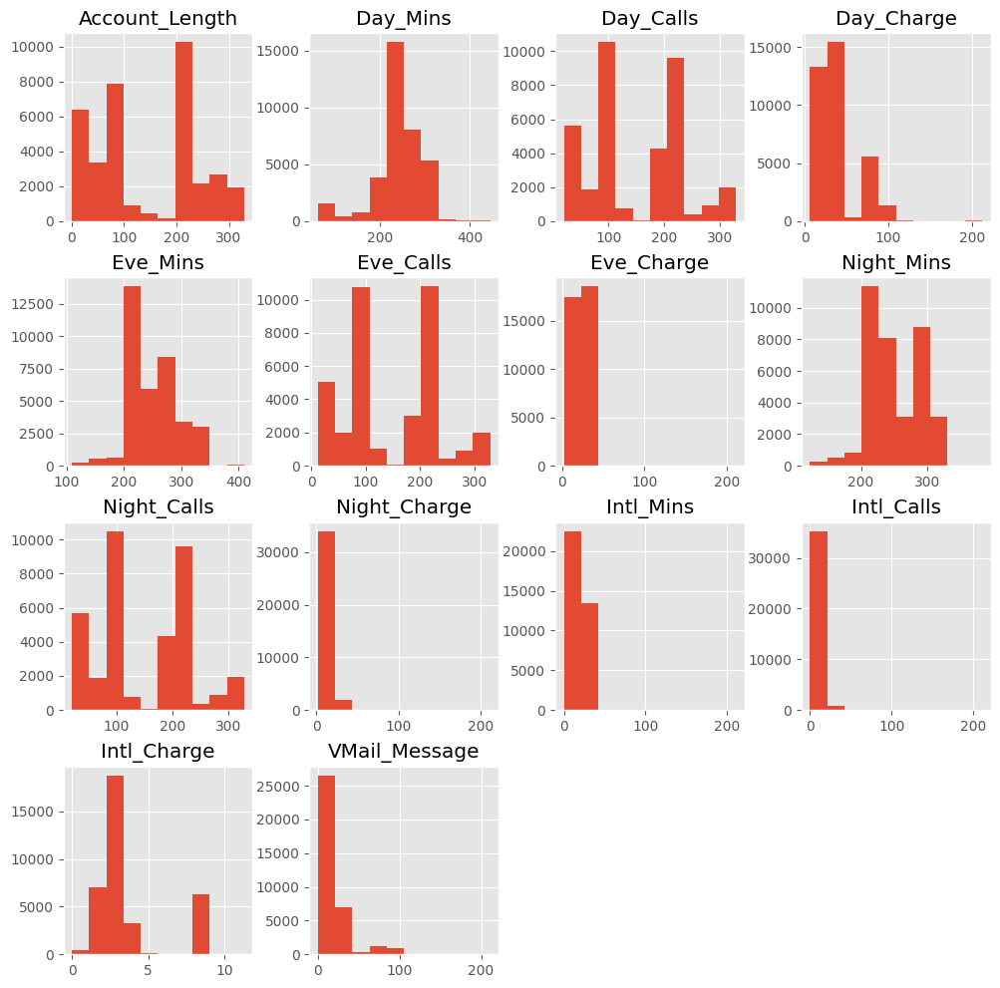

In [46]:
# histograms
df[numeric_cols].hist(figsize=(12, 12))
plt.show()

- those columns which have been included for outlier removal has less skewed distribution now

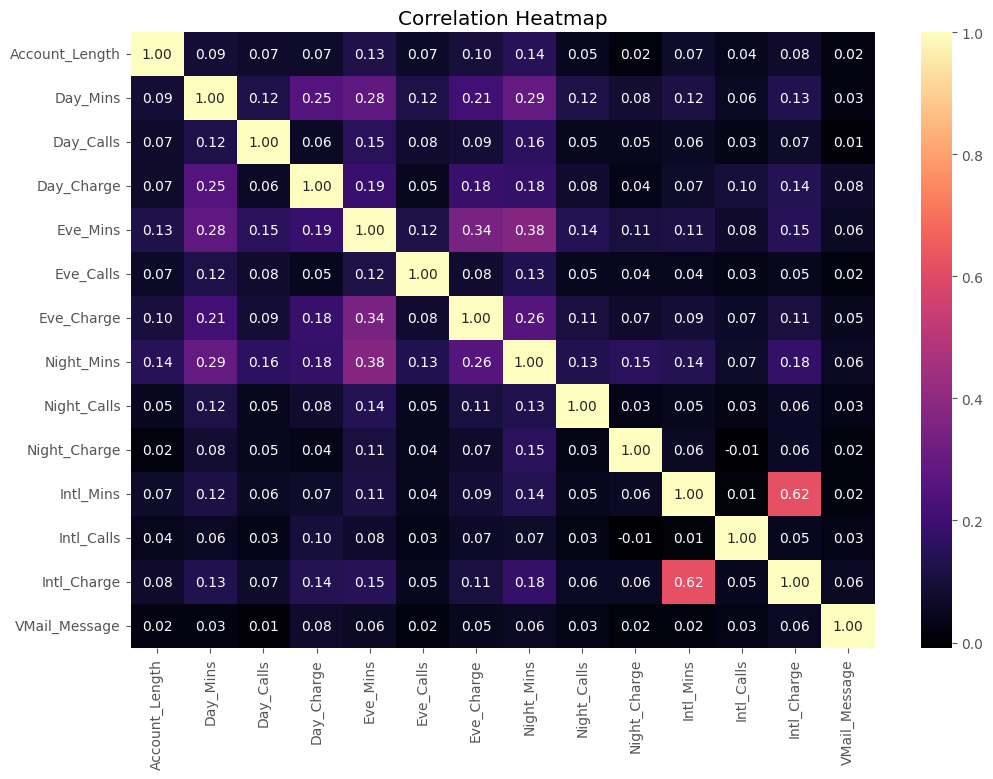

In [47]:
# correlation heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(df[numeric_cols].corr(), annot=True, fmt='.2f', cmap='magma')
plt.title('Correlation Heatmap')
plt.show()

- High correlation between intl_mins and intl_charge which is apparent and expected
- day_mins have 0.25 corr with day_charge
- eve_mins have 0.34 corr with eve_charge
- night_mins have 0.15 corr with night_charge (which is relatively low)
- corr of intl_charge with day_mins, eve_mins & night_mins 0.15 <= corr < 0.20 indicates that these calls are talked around those timeframe?

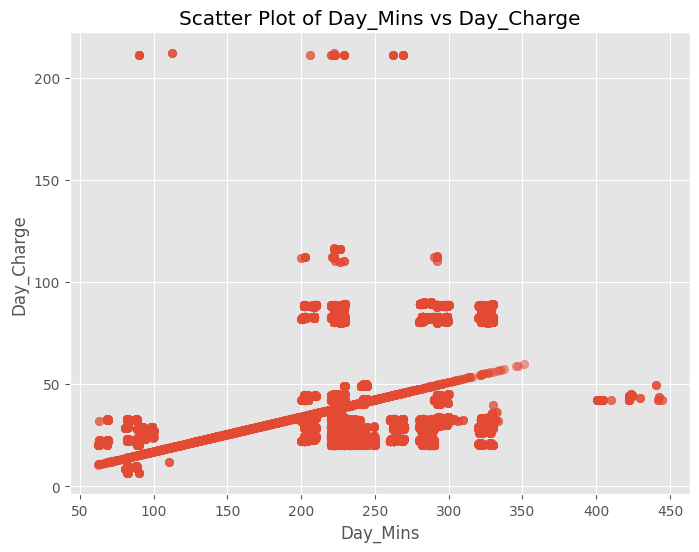

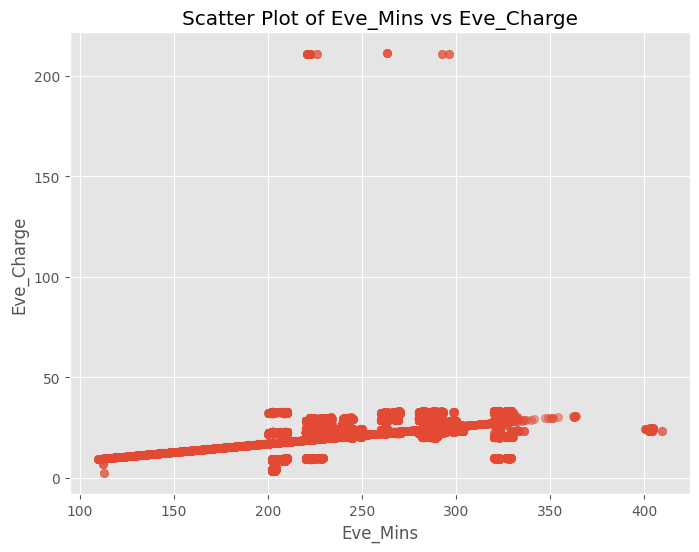

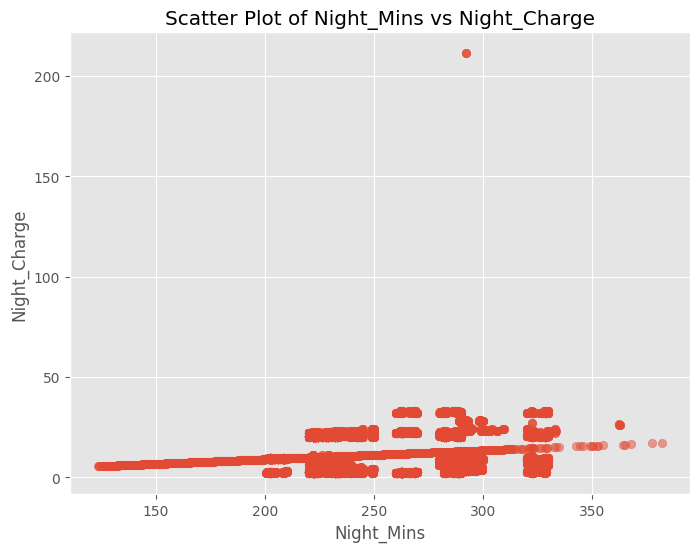

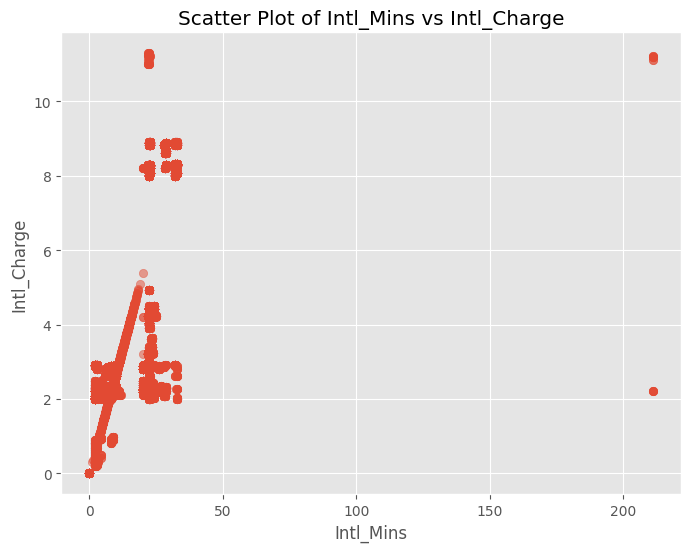

In [48]:
# List of feature pairs 
feature_pairs = [
    ('Day_Mins', 'Day_Charge'),
    ('Eve_Mins', 'Eve_Charge'),
    ('Night_Mins', 'Night_Charge'),
    ('Intl_Mins', 'Intl_Charge'),
    # ...
]

# scatter plots for each pair
for x, y in feature_pairs:
    plt.figure(figsize=(8, 6))
    plt.scatter(df[x], df[y], alpha=0.5)
    plt.xlabel(x)
    plt.ylabel(y)
    plt.title(f'Scatter Plot of {x} vs {y}')
    plt.show()


- Shows somewhat linear relationship indicating as mins increases so does price (charge) across day, eve, night & intl

(array([2.6028e+04, 5.0000e+02, 5.0710e+03, 1.9090e+03, 3.9100e+02,
        0.0000e+00, 0.0000e+00, 1.1630e+03, 9.4700e+02, 0.0000e+00,
        1.3000e+01, 3.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.0000e+00]),
 array([  0.  ,  10.55,  21.1 ,  31.65,  42.2 ,  52.75,  63.3 ,  73.85,
         84.4 ,  94.95, 105.5 , 116.05, 126.6 , 137.15, 147.7 , 158.25,
        168.8 , 179.35, 189.9 , 200.45, 211.  ]),
 <BarContainer object of 20 artists>)

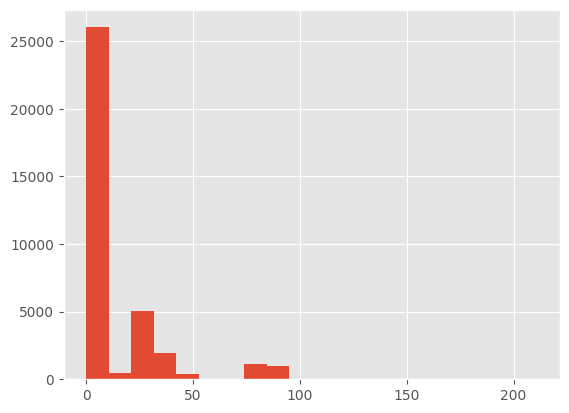

In [49]:
plt.hist(df['VMail_Message'], bins=20)

- just checking the vmailmessage feature for anything unusual

In [50]:
# # pairplot
# sns.set()
# sns.pairplot(df[numeric_cols],size = 2 ,kind ='scatter',diag_kind='kde')
# plt.show()

- bunch of pair plots for all numeric features
- some sort of groups are observed in the above viz indicating potential for clustering

In [51]:
# # violin plot
# for num_col in numeric_cols:
#     sns.catplot(x='Churn', y=num_col, kind='violin', data=df, palette='Set2')
#     plt.title(f'Violin Plot of {num_col} by Churn')
#     plt.xticks(rotation=45)  # Rotate x labels if they overlap
#     plt.show()

In [52]:
# df.to_csv("cleaned_churn.csv")

In [53]:
df.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls
count,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000,36033.000000
mean,147.928205,11.216607,241.267724,149.078456,39.768770,249.978860,148.892904,24.370483,250.316727,148.205673,11.650730,15.632100,4.838315,3.703050,2.181084
std,96.566663,22.171680,53.103504,86.367865,24.035258,40.496675,86.248911,6.932231,39.543004,86.024933,8.339419,9.964079,4.686556,2.290302,2.014803
min,1.000000,0.000000,62.300000,20.000000,6.220000,109.600000,12.000000,2.110000,123.500000,20.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,62.000000,0.000000,222.200000,87.000000,23.230000,222.400000,86.000000,22.220000,222.400000,86.000000,4.920000,8.200000,2.000000,2.280000,2.000000
50%,115.000000,0.000000,232.200000,113.000000,29.240000,234.400000,112.000000,23.220000,234.400000,112.000000,9.200000,20.000000,3.000000,2.820000,2.000000
75%,224.000000,22.000000,282.800000,222.000000,42.420000,282.900000,222.000000,28.280000,286.200000,222.000000,20.290000,22.300000,8.000000,4.000000,2.000000
max,329.000000,211.000000,444.400000,329.000000,211.990000,409.200000,329.000000,211.260000,381.900000,329.000000,211.220000,211.200000,211.000000,11.290000,11.000000


# Clustering for whole dataset

- clustering be performed on only the numerical features so specifying the numeric_cols below to work with instead of dropping the phone_number and churn feature

## Standardizing data

- for performing clustering features need to be standardized so they have the same scale

In [54]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

#creating a copy of the df and using that for normalizing
df_standardized = df.copy()

scaler = StandardScaler()

#redifining numeric cols cuz added 2 new aggregate features
numeric_cols = ['Account_Length', 'VMail_Message', 'Day_Mins', 'Day_Calls', 'Day_Charge', 
                    'Eve_Mins', 'Eve_Calls', 'Eve_Charge', 'Night_Mins', 'Night_Calls', 
                    'Night_Charge', 'Intl_Mins', 'Intl_Calls', 'Intl_Charge', 'CustServ_Calls'
               ]

df_standardized[numeric_cols] = scaler.fit_transform(df_standardized[numeric_cols])


print(df_standardized.describe())

       Account_Length  VMail_Message      Day_Mins     Day_Calls  \
count    3.603300e+04   3.603300e+04  3.603300e+04  3.603300e+04   
mean     7.020043e-17  -5.205875e-17 -2.520117e-16 -3.470583e-17   
std      1.000014e+00   1.000014e+00  1.000014e+00  1.000014e+00   
min     -1.521542e+00  -5.059050e-01 -3.370215e+00 -1.494540e+00   
25%     -8.898454e-01  -5.059050e-01 -3.590721e-01 -7.187780e-01   
50%     -3.409941e-01  -5.059050e-01 -1.707580e-01 -4.177359e-01   
75%      7.877755e-01   4.863656e-01  7.821113e-01  8.443251e-01   
max      1.875122e+00   9.010872e+00  3.825267e+00  2.083229e+00   

         Day_Charge      Eve_Mins     Eve_Calls    Eve_Charge    Night_Mins  \
count  3.603300e+04  3.603300e+04  3.603300e+04  3.603300e+04  3.603300e+04   
mean  -1.135827e-16  2.464903e-16 -5.048121e-17  3.013097e-16 -7.465698e-16   
std    1.000014e+00  1.000014e+00  1.000014e+00  1.000014e+00  1.000014e+00   
min   -1.395834e+00 -3.466477e+00 -1.587206e+00 -3.211202e+00 -3.207103

In [55]:
df_standardized.head()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn
0,382-4657,-0.206370,0.621675,0.448795,-0.452472,0.220564,-1.298368,-0.578484,-1.094970,-0.142043,-0.664999,-0.076833,-0.565248,-0.392258,-0.437961,-0.586211,False
1,371-7191,-0.423840,0.666778,-1.500256,-0.301950,-0.511704,-1.345286,-0.532106,-1.118051,0.103263,-0.525502,-0.024070,-0.193909,-0.392258,-0.001332,-0.586211,False
2,358-1921,-0.113169,-0.505905,0.040154,-0.406157,0.067037,-3.180030,-0.450944,-2.029747,-2.218292,-0.513878,-0.519316,-0.344452,0.034500,-0.180350,-1.082545,False
3,330-6626,-0.755221,-0.505905,-1.404215,-0.417736,-0.475507,-2.510830,-0.311810,-1.696517,-1.603763,-0.316258,-0.388609,-0.555212,-0.392258,-0.424862,0.406455,False
4,391-8027,-0.309927,-0.505905,-0.336474,-0.591414,-0.074424,-0.725474,-0.555295,-0.810787,-1.173845,-0.351132,-0.296275,-0.936587,0.247879,-0.874591,-1.082545,False


- in case there's need for standardized features 

# DR first then clustering

- just to compare the results of doing either clustering /dr prior will result in different clusters and faster runtime?

## PCA

In [56]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
pca_df = pd.DataFrame()
pca_df['PC1'] = principal_components[:, 0]
pca_df['PC2'] = principal_components[:, 1]

### pca then kmeans

In [57]:
from sklearn.cluster import KMeans

optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(pca_df)

pca_df['Cluster'] = cluster_labels

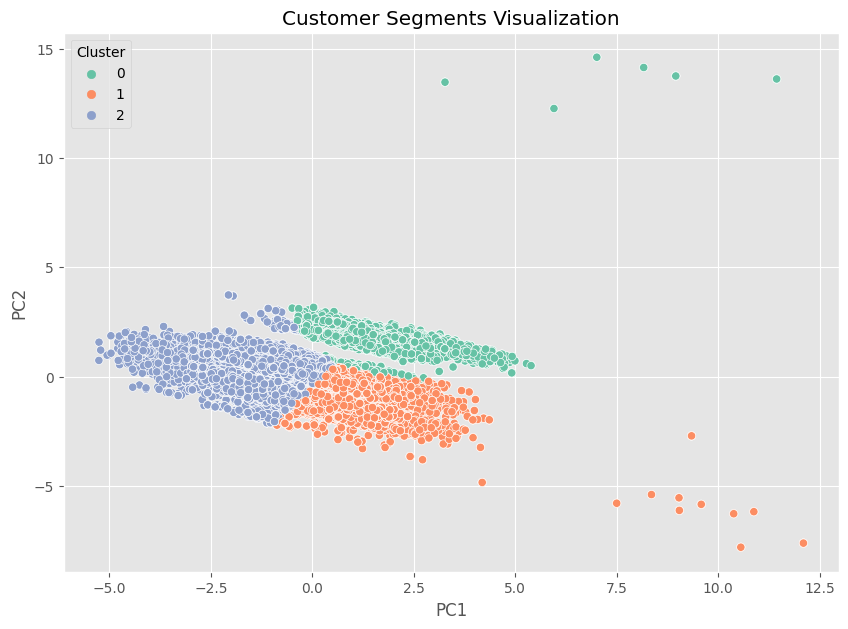

In [58]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()


In [59]:
pca_df = pca_df.drop('Cluster', axis=1)

In [60]:
pca_df

,PC1,PC2
0,-1.437656,0.018861
1,-1.978307,0.872092
2,-3.477440,1.256355
3,-3.553852,0.915444
4,-2.228027,-0.395458
...,...,...
36028,0.218472,-0.792260
36029,-0.241339,0.128867
36030,-0.908774,-0.834873
36031,1.168117,-1.218550


### pca then dbscan

In [61]:
from sklearn.cluster import DBSCAN

# DBSCAN with PCA
dbscan = DBSCAN(eps=2, min_samples=3)
cluster_labels = dbscan.fit_predict(pca_df)
pca_df['Cluster'] = cluster_labels

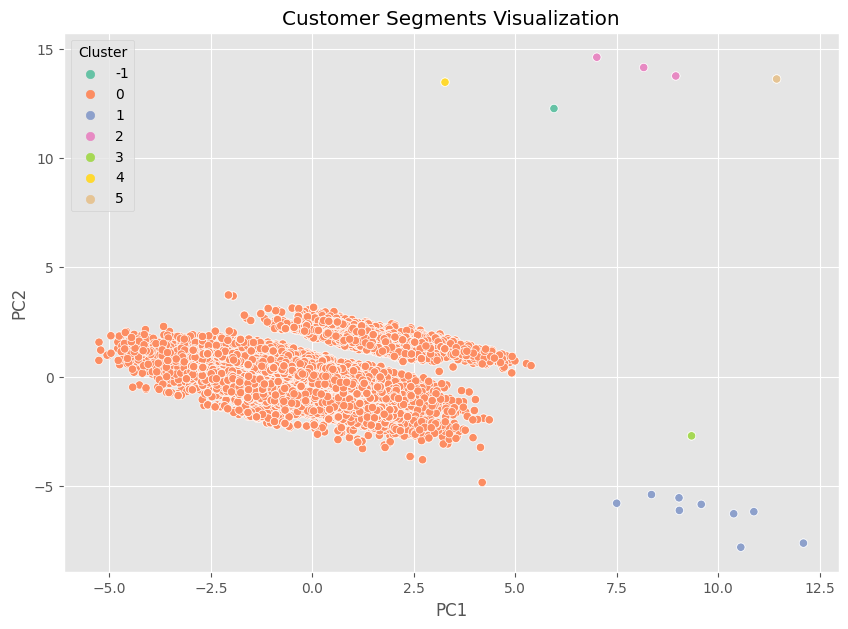

In [62]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [63]:
pca_df = pca_df.drop('Cluster', axis=1)

### pca then hierarchical

In [64]:
from sklearn.cluster import AgglomerativeClustering

# Hierarchical Clustering
n_clusters = 3  # You can adjust this
hierarchical = AgglomerativeClustering(n_clusters=n_clusters)
cluster_labels = hierarchical.fit_predict(pca_df)
pca_df['Cluster'] = cluster_labels

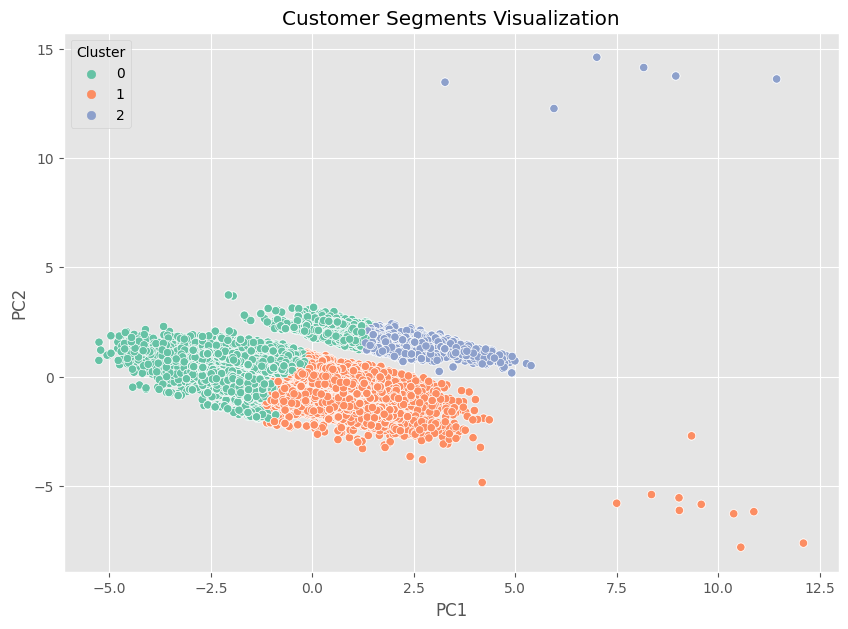

In [65]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [66]:
pca_df = pca_df.drop('Cluster', axis=1)

### pca then meanshift

In [67]:
from sklearn.cluster import MeanShift, estimate_bandwidth


# Mean Shift
bandwidth = estimate_bandwidth(pca_df, quantile=0.3)
meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
cluster_labels = meanshift.fit_predict(pca_df)
pca_df['Cluster'] = cluster_labels

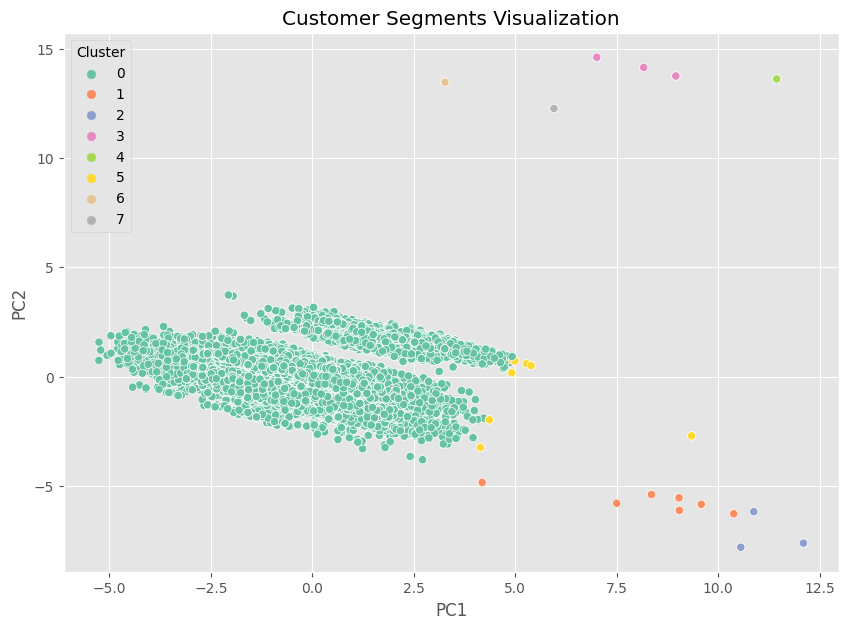

In [68]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [69]:
pca_df = pca_df.drop('Cluster', axis=1)

## t-SNE

In [70]:
from sklearn.manifold import TSNE

# t-SNE
tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
tsne_results = tsne.fit_transform(df_standardized[numeric_cols])

tsne_df = pd.DataFrame()

tsne_df['TSNE1'] = tsne_results[:, 0]
tsne_df['TSNE2'] = tsne_results[:, 1]

### t-sne with kmeans

In [71]:
from sklearn.cluster import KMeans

optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(tsne_df)

tsne_df['Cluster'] = cluster_labels

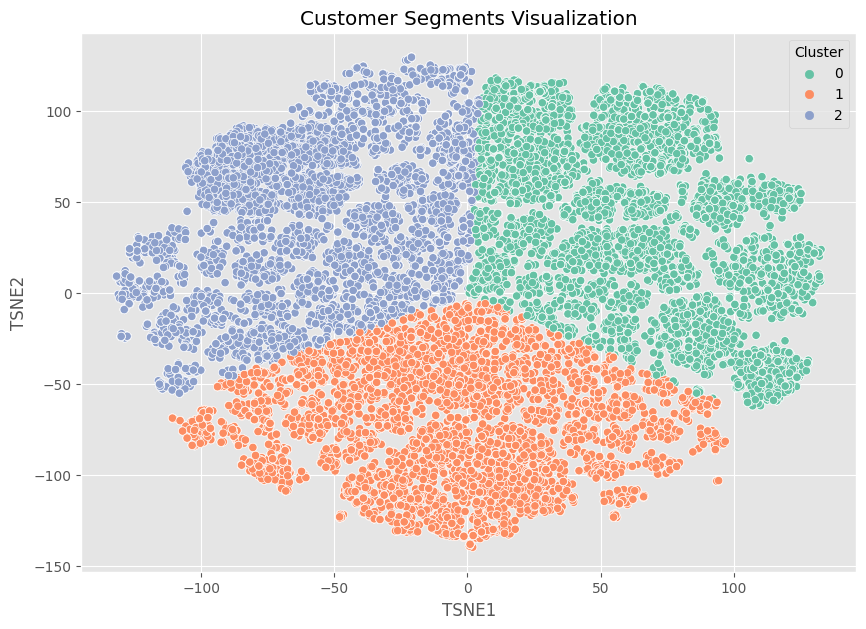

In [72]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=tsne_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [73]:
tsne_df = tsne_df.drop('Cluster', axis=1)

### t-sne with dbscan

In [74]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=5, min_samples=10)
cluster_labels = dbscan.fit_predict(tsne_df)
tsne_df['Cluster'] = cluster_labels

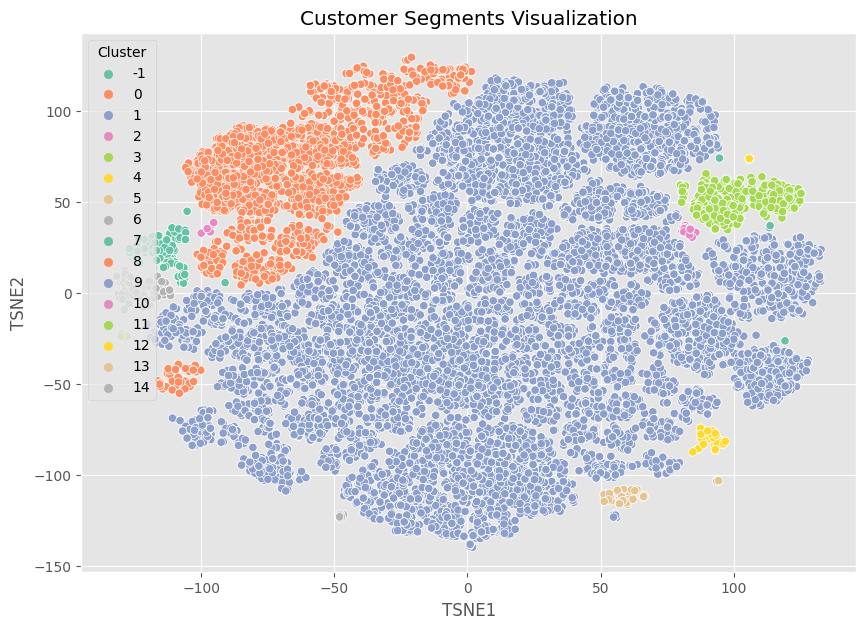

In [75]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=tsne_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [76]:
tsne_df = tsne_df.drop('Cluster', axis=1)

### tsne then hierarchical

In [77]:
from sklearn.cluster import AgglomerativeClustering

# Hierarchical Clustering
n_clusters = 3  # You can adjust this
hierarchical = AgglomerativeClustering(n_clusters=n_clusters)
cluster_labels = hierarchical.fit_predict(tsne_df)
tsne_df['Cluster'] = cluster_labels

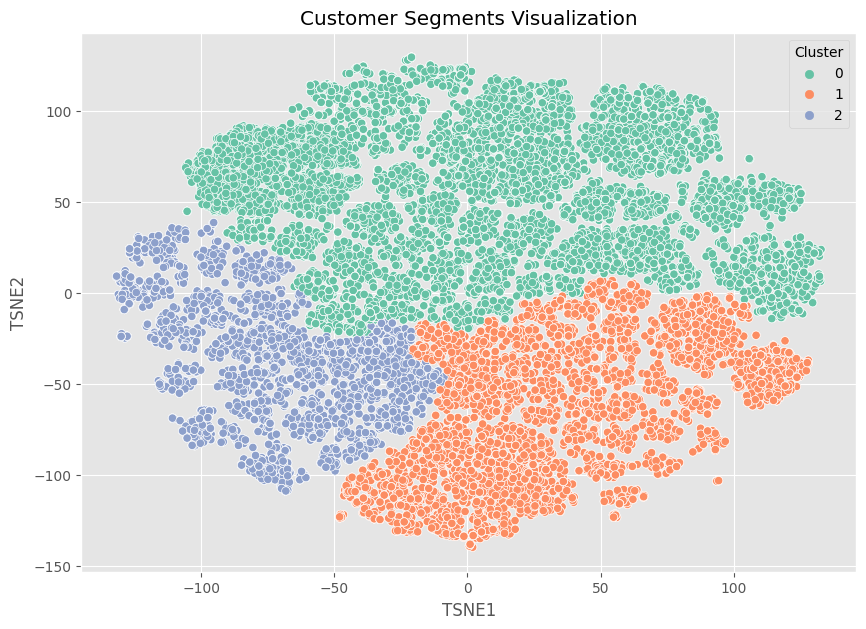

In [78]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=tsne_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [79]:
tsne_df = tsne_df.drop('Cluster', axis=1)

### tsne then meanshift

In [80]:
from sklearn.cluster import MeanShift, estimate_bandwidth


# Mean Shift
bandwidth = estimate_bandwidth(tsne_df, quantile=0.2)
meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
cluster_labels = meanshift.fit_predict(tsne_df)
tsne_df['Cluster'] = cluster_labels

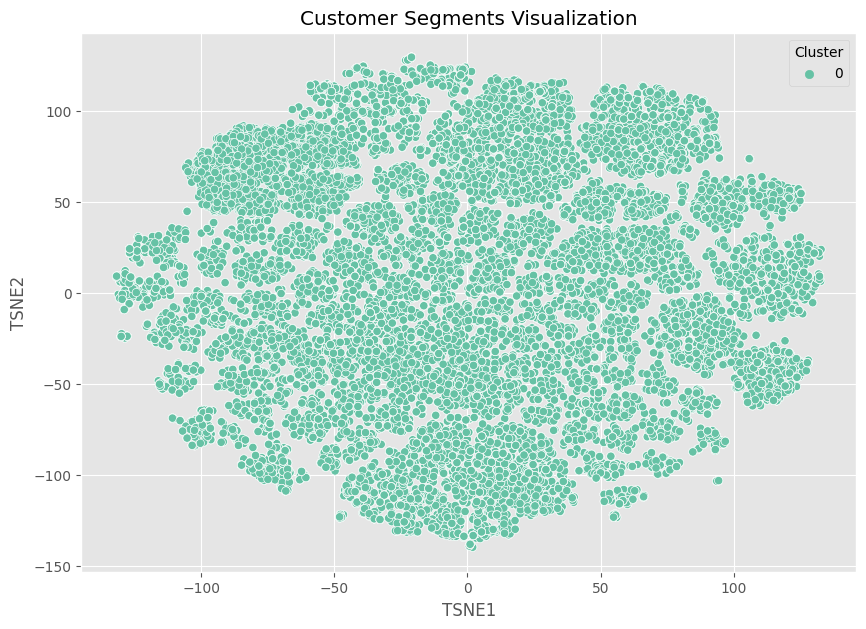

In [81]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=tsne_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [82]:
tsne_df = tsne_df.drop('Cluster', axis=1)

## UMAP

In [83]:
# UMAP
import umap

# noise = np.random.normal(loc=0, scale=1e-5, size=df_standardized[numeric_cols].shape)
# df_noisy = df_standardized[numeric_cols] + noise

umap_reducer = umap.UMAP(n_components=2, n_neighbors=10, min_dist=0.05, random_state=42)
umap_results = umap_reducer.fit_transform(df_standardized[numeric_cols])

umap_df = pd.DataFrame()

umap_df['UMAP1'] = umap_results[:, 0]
umap_df['UMAP2'] = umap_results[:, 1]

2024-08-15 13:59:16.680855: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-15 13:59:16.681073: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-15 13:59:16.836351: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation 

### umap then kmeans

In [84]:
from sklearn.cluster import KMeans

optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(umap_df)

umap_df['Cluster'] = cluster_labels

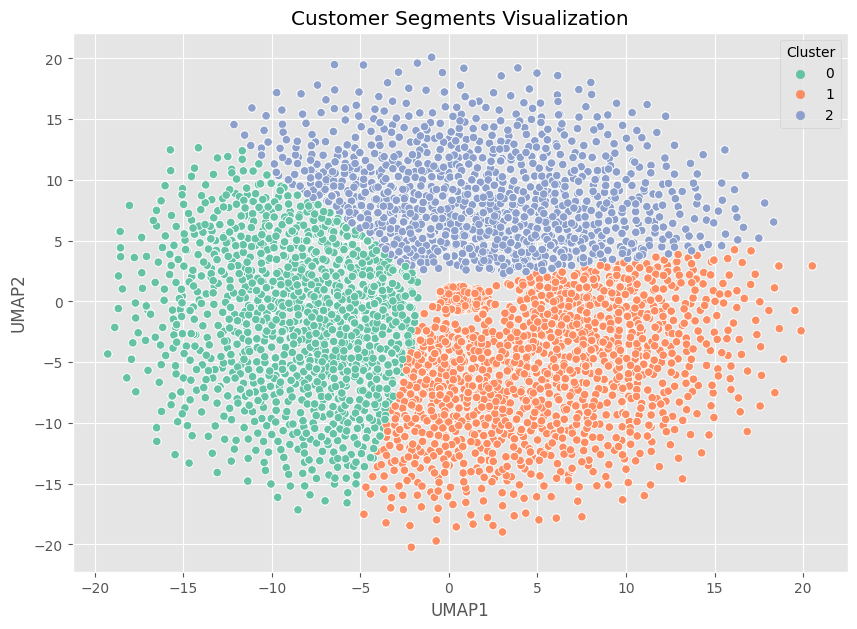

In [85]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=umap_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [86]:
umap_df = umap_df.drop('Cluster', axis=1)

### umap then dbscan

In [87]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=5, min_samples=10)
cluster_labels = dbscan.fit_predict(umap_df)
umap_df['Cluster'] = cluster_labels

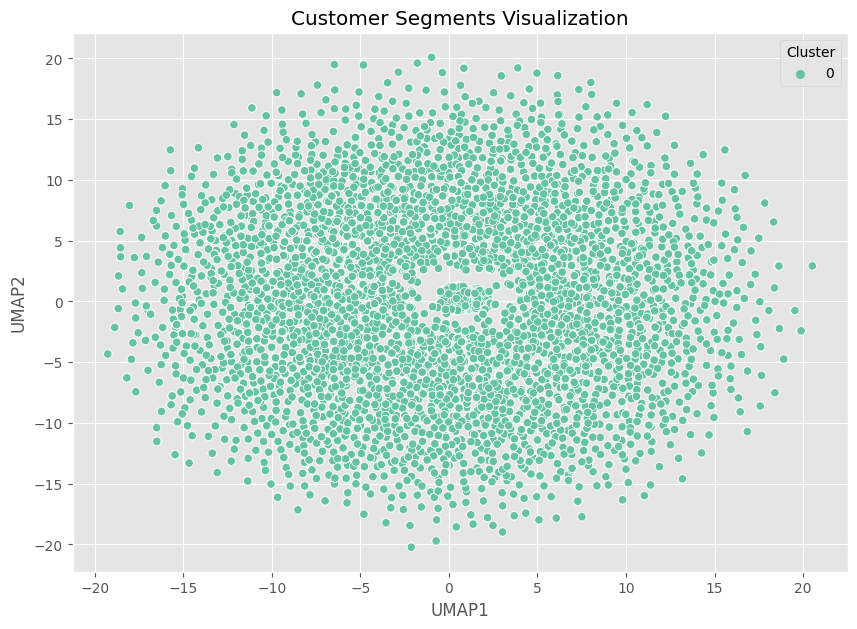

In [88]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=umap_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [89]:
umap_df = umap_df.drop('Cluster', axis=1)

### umap then hierarchical

In [90]:
from sklearn.cluster import AgglomerativeClustering

# Hierarchical Clustering
n_clusters = 3  # You can adjust this
hierarchical = AgglomerativeClustering(n_clusters=n_clusters)
cluster_labels = hierarchical.fit_predict(umap_df)
umap_df['Cluster'] = cluster_labels

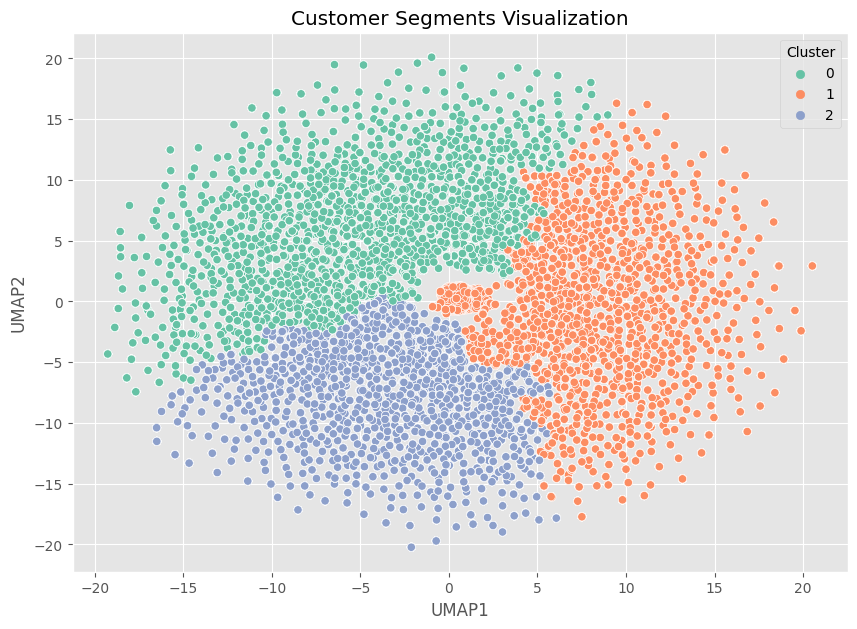

In [91]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=umap_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [92]:
umap_df = umap_df.drop('Cluster', axis=1)

### umap then meanshift

In [93]:
from sklearn.cluster import MeanShift, estimate_bandwidth


# Mean Shift
bandwidth = estimate_bandwidth(umap_df, quantile=0.2)
meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
cluster_labels = meanshift.fit_predict(umap_df)
umap_df['Cluster'] = cluster_labels

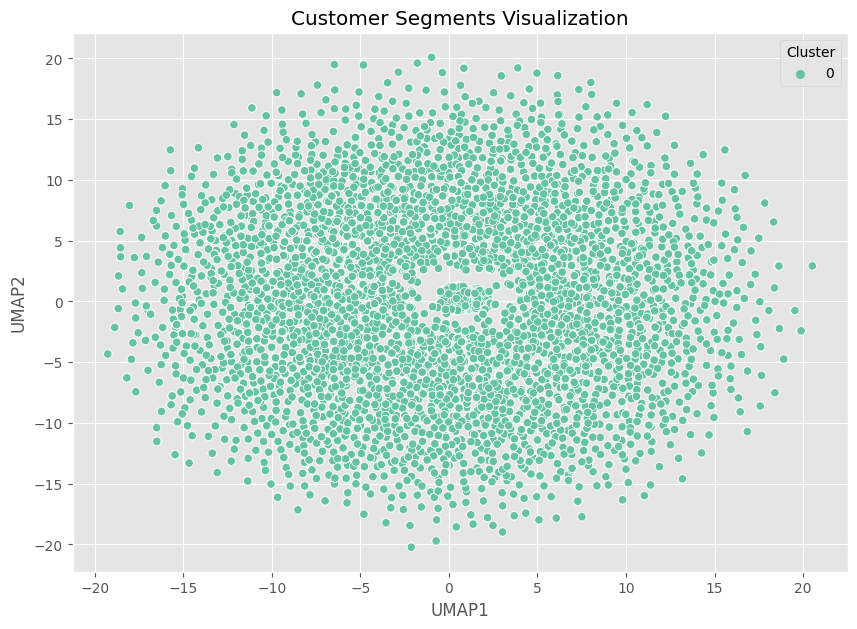

In [94]:
plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=umap_df, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()

In [95]:
umap_df = umap_df.drop('Cluster', axis=1)

# Clustering first then DR

## KMeans

### With PCA

### Elbow method to identify optimal cluster (k) where in we are to identify using the wcss score

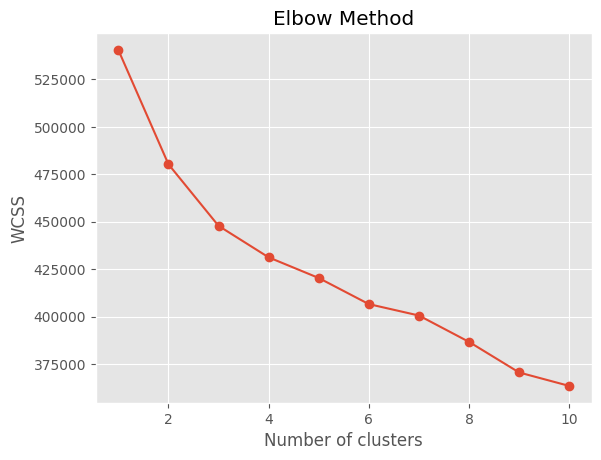

In [96]:
from sklearn.cluster import KMeans

wcss = []  # Within-cluster sum of squares

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init='auto')
    kmeans.fit(df_standardized[numeric_cols])
    wcss.append(kmeans.inertia_)

# Plotting
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()


### Once again to identify/double-check we use silhouette score to identify the optimal cluster center based on silhouette avg

In [97]:
# from sklearn.metrics import silhouette_score

# for n_clusters in range(2, 11):
#     kmeans = KMeans(n_clusters=n_clusters, n_init='auto' ,random_state=42)
#     cluster_labels = kmeans.fit_predict(df_standardized[numeric_cols])
#     silhouette_avg = silhouette_score(df_standardized[numeric_cols], cluster_labels)
#     print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg}")


- based on silhouette score the optimal cluster is either 2 / 3/ 4

In [98]:
#taking 3 clusters
optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(df_standardized[numeric_cols])

df_standardized['Cluster'] = cluster_labels


- applying K-means clustering algorithm onto the sclaed data with 3 cluster centers identified as optimal from the elbow&silhouette method

In [99]:
# df_standardized.describe()

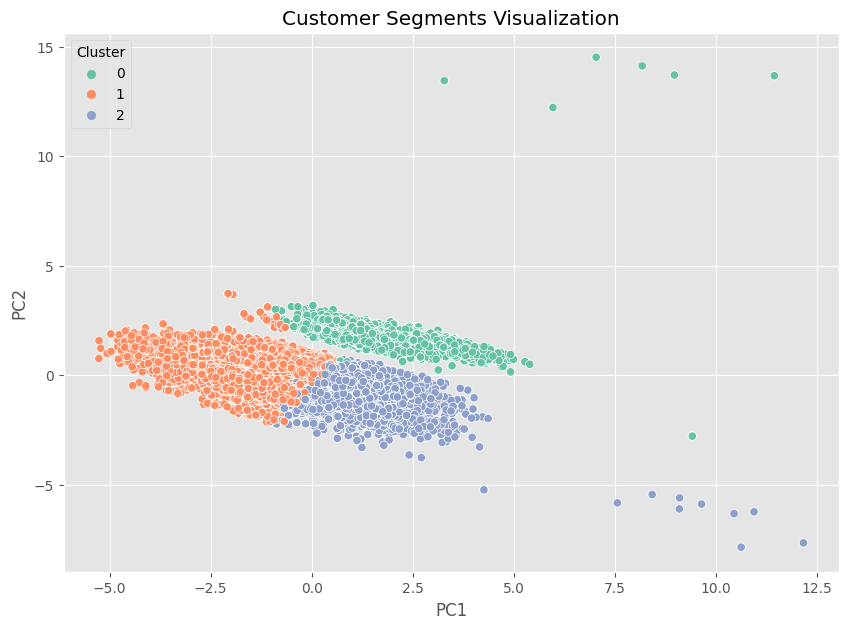

In [100]:
from sklearn.decomposition import PCA

# Reduce to 2 principal components for visualization
pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
df_standardized['PC1'] = principal_components[:, 0]
df_standardized['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization')
plt.show()


- we're able to see 3 clear/well-defined clusters, after 3 it gets kinda messy 

/opt/conda/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


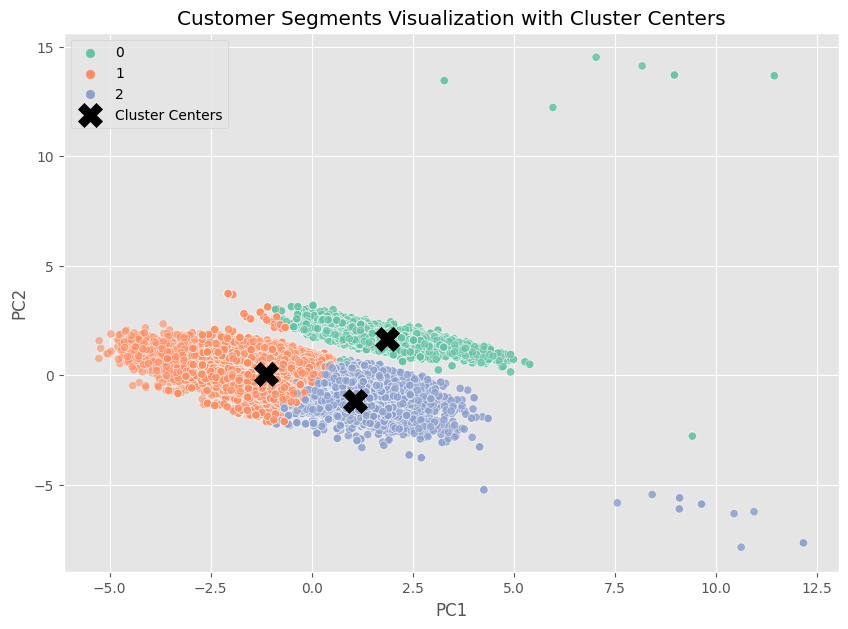

In [101]:
# Get cluster centers in the PCA space
centers_pca = pca.transform(kmeans.cluster_centers_)

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2', alpha=0.6)
plt.scatter(centers_pca[:, 0], centers_pca[:, 1], s=300, c='black', marker='X', label='Cluster Centers')
plt.title('Customer Segments Visualization with Cluster Centers')
plt.legend()
plt.show()

- visualizing with the cluster centroids

In [102]:
df['Cluster'] = df_standardized['Cluster']

- copied the cluster lables to orignal df for visualizing with actual values on other features (non-normalized)

In [103]:
# df.describe(include='all')

In [104]:
pd.set_option('display.max_rows', None)
cluster_summary = df.groupby('Cluster').describe().T
# cluster_summary


### displaying the mean values across the features across the clusters

In [105]:
mean_values = cluster_summary.xs('mean', level=1)

mean_values

Cluster,0,1,2
Account_Length,167.562998,129.247282,172.995654
VMail_Message,14.266507,8.406332,14.926731
Day_Mins,260.568756,221.208813,269.313501
Day_Calls,165.437959,131.465774,174.076402
Day_Charge,48.655601,30.130149,53.490820
Eve_Mins,266.556478,230.970082,277.641796
Eve_Calls,160.751994,132.790920,173.709247
Eve_Charge,26.435493,22.233684,27.352424
Night_Mins,269.031589,231.542696,276.154046
Night_Calls,163.201754,133.083350,169.067206


- Cluster 0: Heavy overall usage, long account length, higher customer service interactions
- Cluster 1: Lower overall usage, shorter account length, minimal customer service interactions
- Cluster 2: Highest overall usage, long account length, moderate customer service interactions

inferred by referencing the mean values

### churn rate in each cluster

Cluster
0    0.129984
1    0.110479
2    0.115513
Name: Churn, dtype: float64


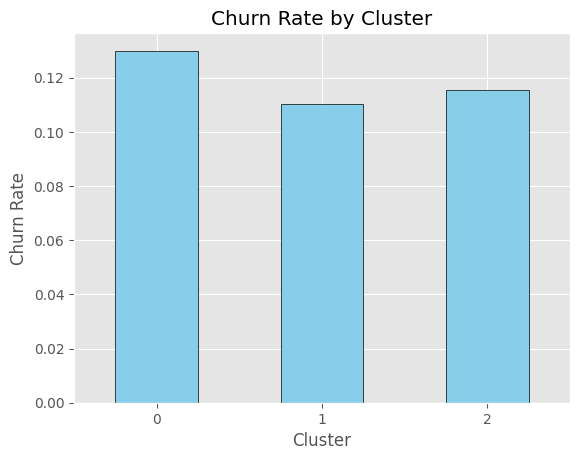

In [106]:
df['Churn'] = df['Churn'].astype(int)

churn_rate_per_cluster = df.groupby('Cluster')['Churn'].mean()

print(churn_rate_per_cluster)

churn_rate_per_cluster.plot(kind='bar', color='skyblue', edgecolor='black')
plt.xlabel('Cluster')
plt.ylabel('Churn Rate')
plt.title('Churn Rate by Cluster')
plt.xticks(rotation=0)
plt.show()

- Cluter 0 has the highest Churn rate indicating that the customers who have churned the most are in this clustering thereby more customers could also have potential to churn
- Although the churn rate between clusters aren't that much different

In [107]:
df.head()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn,Cluster
0,382-4657,128,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0,1
1,371-7191,107,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0,1
2,358-1921,137,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0,1
3,330-6626,75,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0,1
4,391-8027,118,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,0,1


### Dropping the cluster, pc1 & pc2 columns so clustering can be performed again on df_standardized (though it can be overwritten I suppose)

In [108]:
df_standardized = df_standardized.drop(['Cluster', 'PC1', 'PC2'], axis=1)

- dropping the above 3 rows in order to perform clustering and dimensionality reduction again

In [109]:
df_standardized.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls
count,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04,3.603300e+04
mean,7.020043e-17,-5.205875e-17,-2.520117e-16,-3.470583e-17,-1.135827e-16,2.464903e-16,-5.048121e-17,3.013097e-16,-7.465698e-16,-1.064838e-16,-1.404009e-16,7.138358e-17,5.994644e-17,-1.577538e-16,9.149719e-17
std,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00,1.000014e+00
min,-1.521542e+00,-5.059050e-01,-3.370215e+00,-1.494540e+00,-1.395834e+00,-3.466477e+00,-1.587206e+00,-3.211202e+00,-3.207103e+00,-1.490352e+00,-1.157258e+00,-1.568867e+00,-1.032396e+00,-1.616862e+00,-1.082545e+00
25%,-8.898454e-01,-5.059050e-01,-3.590721e-01,-7.187780e-01,-6.881141e-01,-6.810249e-01,-7.292124e-01,-3.102194e-01,-7.059938e-01,-7.231222e-01,-8.071093e-01,-7.458996e-01,-6.056375e-01,-6.213458e-01,-8.987803e-02
50%,-3.409941e-01,-5.059050e-01,-1.707580e-01,-4.177359e-01,-4.380613e-01,-3.847001e-01,-4.277551e-01,-1.659637e-01,-4.025225e-01,-4.208800e-01,-2.938770e-01,4.383707e-01,-3.922582e-01,-3.855657e-01,-8.987803e-02
75%,7.877755e-01,4.863656e-01,7.821113e-01,8.443251e-01,1.103074e-01,8.129457e-01,8.476410e-01,5.639702e-01,9.074619e-01,8.578368e-01,1.035970e+00,6.692031e-01,6.746380e-01,1.296574e-01,-8.987803e-02
max,1.875122e+00,9.010872e+00,3.825267e+00,2.083229e+00,7.165458e+00,3.931764e+00,2.088254e+00,2.695988e+01,3.327645e+00,2.101679e+00,2.393117e+01,1.962756e+01,4.399063e+01,3.312688e+00,4.377122e+00


In [110]:
optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(df_standardized[numeric_cols])
df_standardized['Cluster'] = cluster_labels

### pca

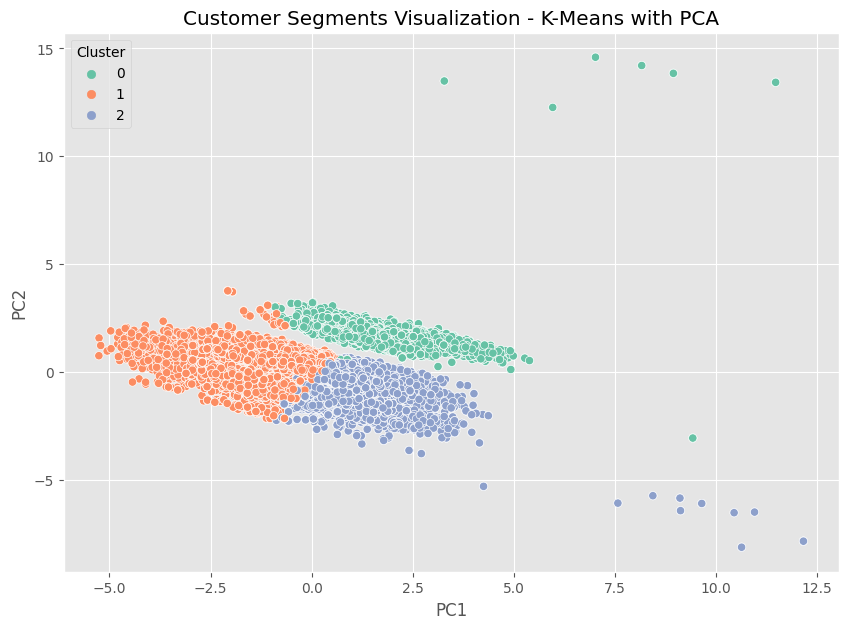

In [111]:
# PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
df_standardized['PC1'] = principal_components[:, 0]
df_standardized['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - K-Means with PCA')
plt.show()

### tsne

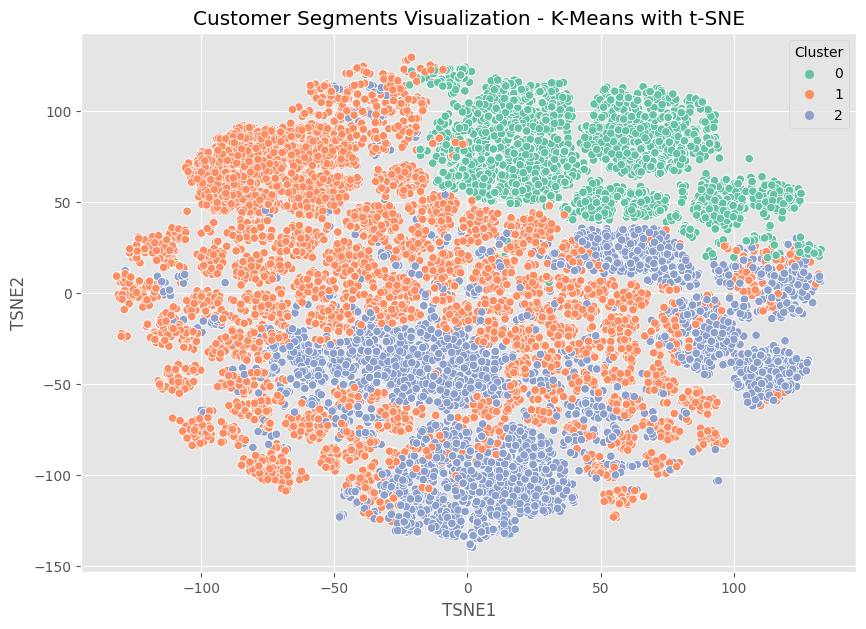

In [112]:
from sklearn.manifold import TSNE

# t-SNE
tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
tsne_results = tsne.fit_transform(df_standardized[numeric_cols])
df_standardized['TSNE1'] = tsne_results[:, 0]
df_standardized['TSNE2'] = tsne_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - K-Means with t-SNE')
plt.show()

### umap

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

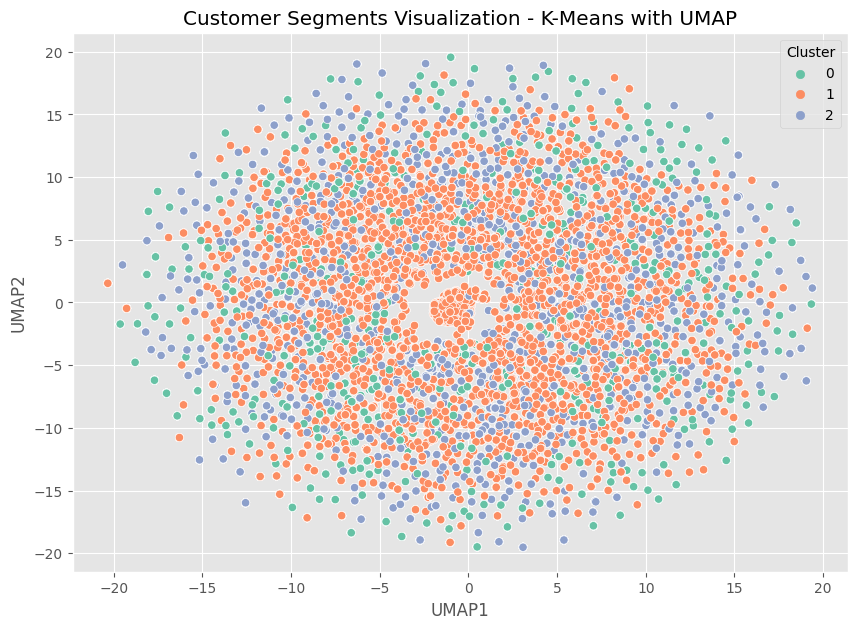

In [113]:
# UMAP
import umap

# noise = np.random.normal(loc=0, scale=1e-5, size=df_standardized[numeric_cols].shape)
# df_noisy = df_standardized[numeric_cols] + noise

umap_reducer = umap.UMAP(n_components=2, n_neighbors=10, min_dist=0.05, random_state=42)
umap_results = umap_reducer.fit_transform(df_standardized[numeric_cols])

df_standardized['UMAP1'] = umap_results[:, 0]
df_standardized['UMAP2'] = umap_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - K-Means with UMAP')
plt.show()

## DBSCAN

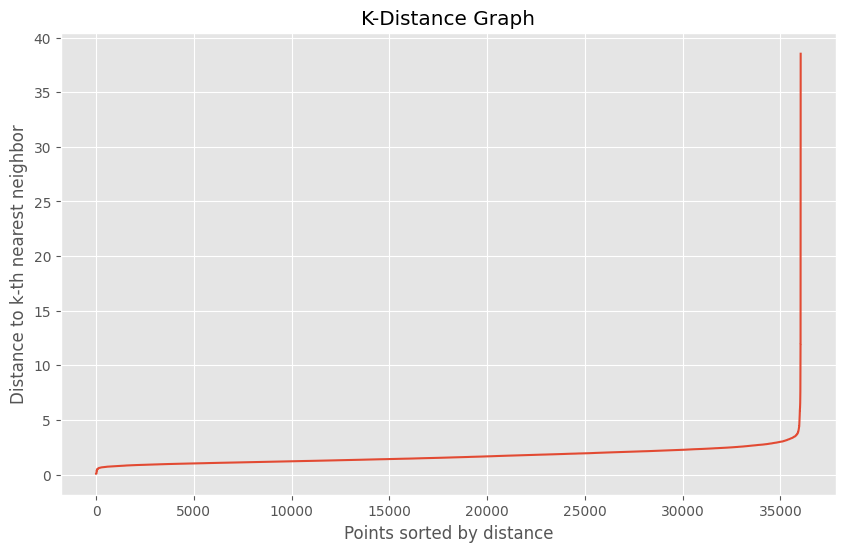

In [114]:
from sklearn.neighbors import NearestNeighbors

# Assuming df_standardized is your DataFrame
X = df_standardized[numeric_cols].values

# Compute k-distances
k = 10  # Try different values if needed
nbrs = NearestNeighbors(n_neighbors=k).fit(X)
distances, indices = nbrs.kneighbors(X)
k_distances = distances[:, -1]

# Plot k-distance graph
k_distances_sorted = np.sort(k_distances)
plt.figure(figsize=(10, 6))
plt.plot(k_distances_sorted)
plt.xlabel('Points sorted by distance')
plt.ylabel('Distance to k-th nearest neighbor')
plt.title('K-Distance Graph')
plt.show()

- looking at the y-axis the sharp icrease occurs at 4 ish so 3 is the optimum for eps parameter?

In [115]:
from sklearn.cluster import DBSCAN

# DBSCAN with PCA
dbscan = DBSCAN(eps=3, min_samples=10)
cluster_labels = dbscan.fit_predict(df_standardized[numeric_cols])
df_standardized['Cluster'] = cluster_labels

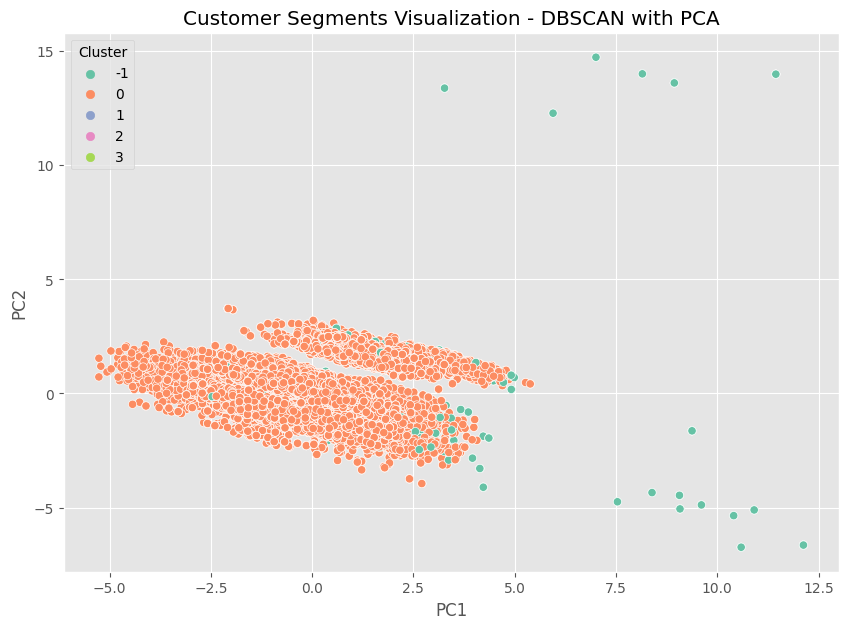

In [116]:
# PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
df_standardized['PC1'] = principal_components[:, 0]
df_standardized['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - DBSCAN with PCA')
plt.show()

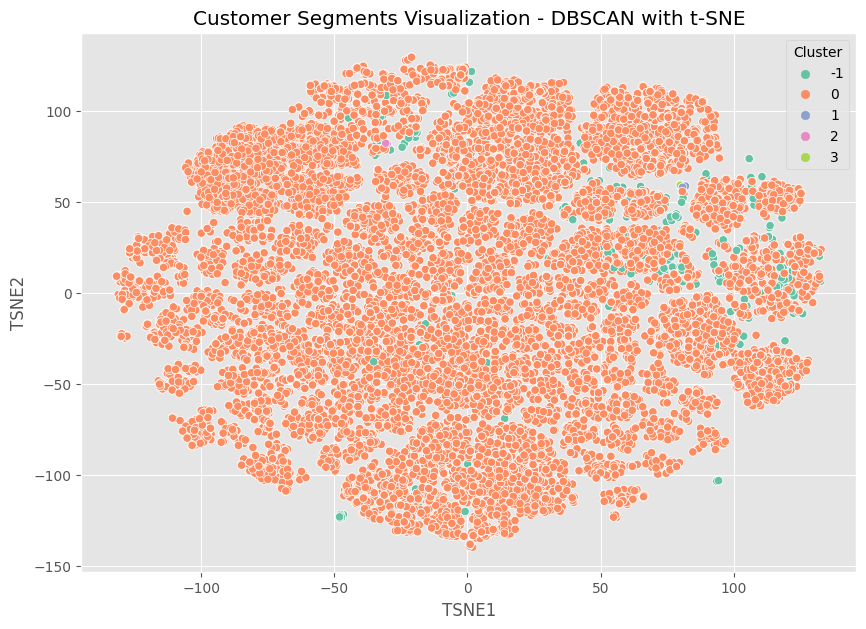

In [117]:
# t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_standardized[numeric_cols])
df_standardized['TSNE1'] = tsne_results[:, 0]
df_standardized['TSNE2'] = tsne_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - DBSCAN with t-SNE')
plt.show()

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

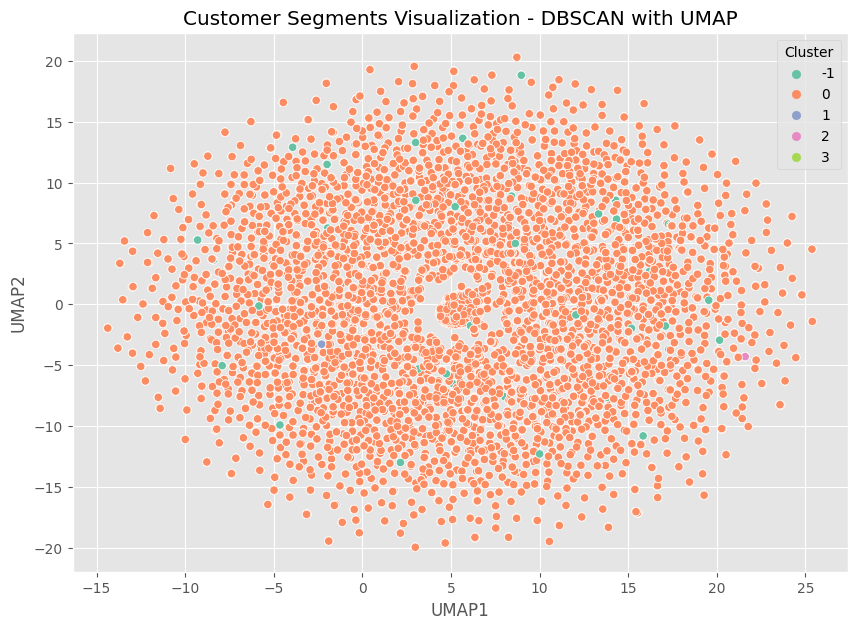

In [118]:
# UMAP
umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_results = umap_reducer.fit_transform(df_standardized[numeric_cols])
df_standardized['UMAP1'] = umap_results[:, 0]
df_standardized['UMAP2'] = umap_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - DBSCAN with UMAP')
plt.show()

## Hierarchical

In [119]:
from sklearn.cluster import AgglomerativeClustering

# Hierarchical Clustering
n_clusters = 3  # You can adjust this
hierarchical = AgglomerativeClustering(n_clusters=n_clusters)
cluster_labels = hierarchical.fit_predict(df_standardized[numeric_cols])
df_standardized['Cluster'] = cluster_labels


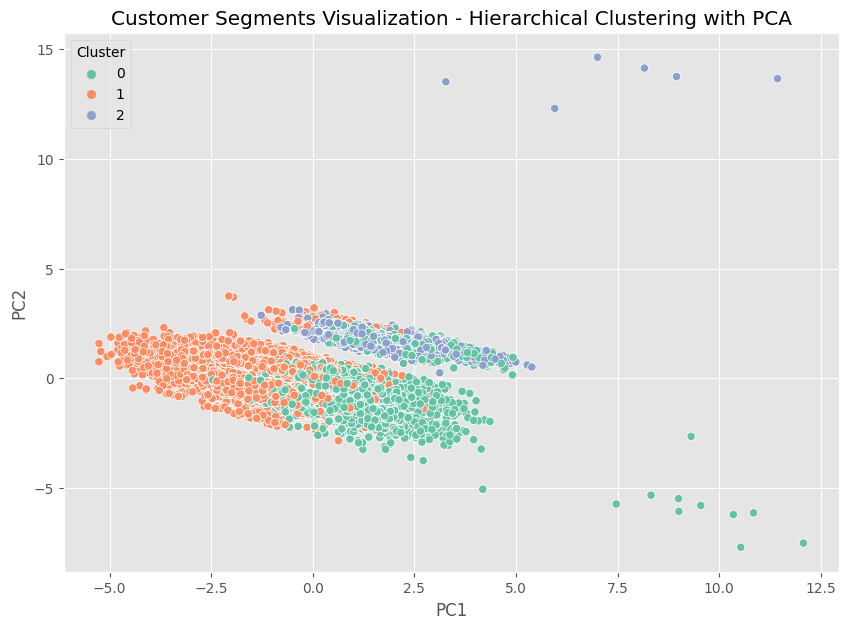

In [120]:
# PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
df_standardized['PC1'] = principal_components[:, 0]
df_standardized['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Hierarchical Clustering with PCA')
plt.show()

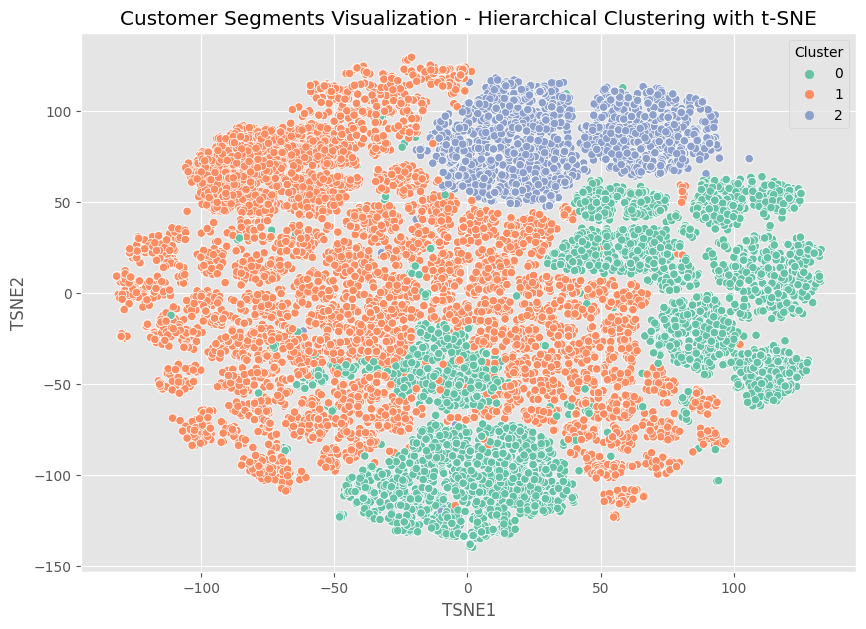

In [121]:
from sklearn.manifold import TSNE

# t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_standardized[numeric_cols])
df_standardized['TSNE1'] = tsne_results[:, 0]
df_standardized['TSNE2'] = tsne_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Hierarchical Clustering with t-SNE')
plt.show()

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

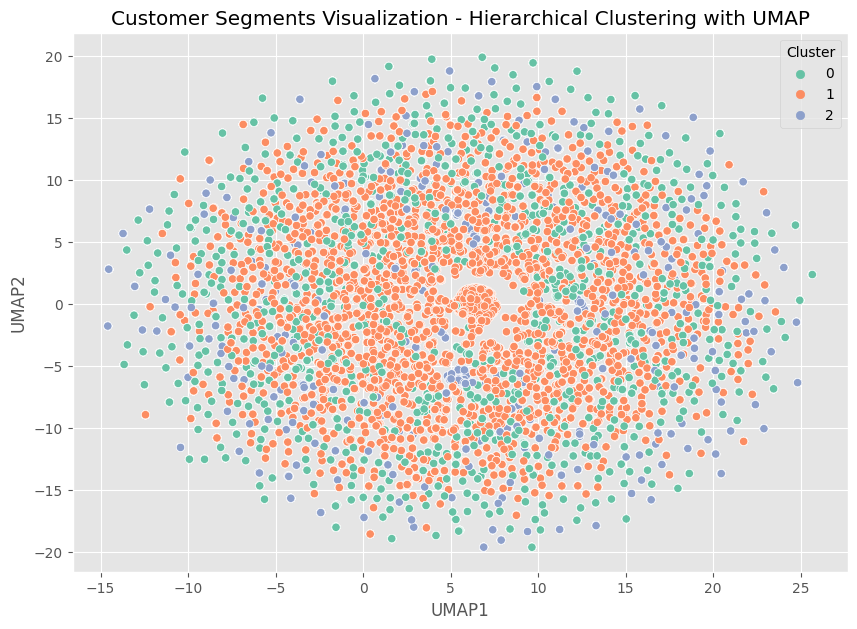

In [122]:
import umap

# UMAP
umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_results = umap_reducer.fit_transform(df_standardized[numeric_cols])
df_standardized['UMAP1'] = umap_results[:, 0]
df_standardized['UMAP2'] = umap_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Hierarchical Clustering with UMAP')
plt.show()

## Meanshift

In [123]:
from sklearn.cluster import MeanShift, estimate_bandwidth


# Mean Shift
bandwidth = estimate_bandwidth(df_standardized[numeric_cols], quantile=0.1)
meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
cluster_labels = meanshift.fit_predict(df_standardized[numeric_cols])
df_standardized['Cluster'] = cluster_labels



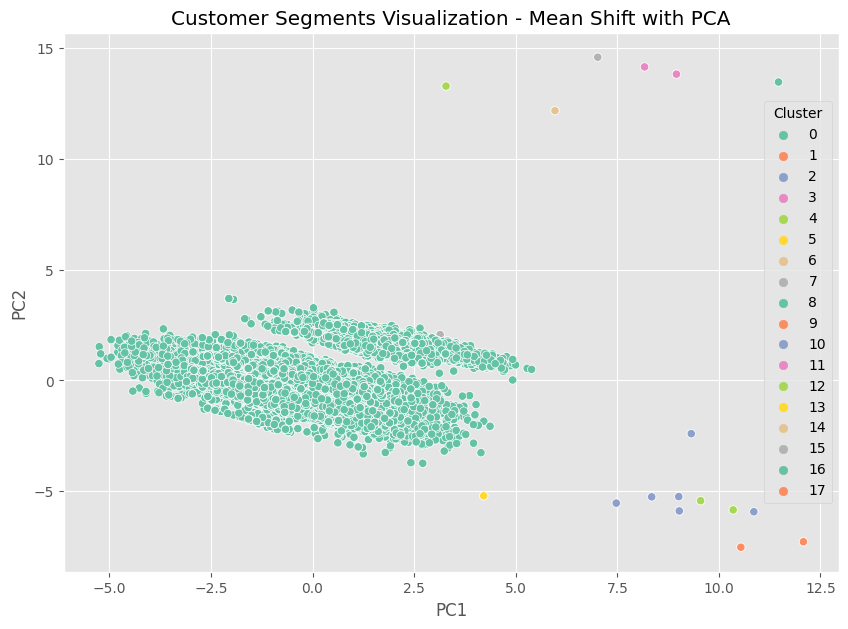

In [124]:
# PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_standardized[numeric_cols])
df_standardized['PC1'] = principal_components[:, 0]
df_standardized['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Mean Shift with PCA')
plt.show()

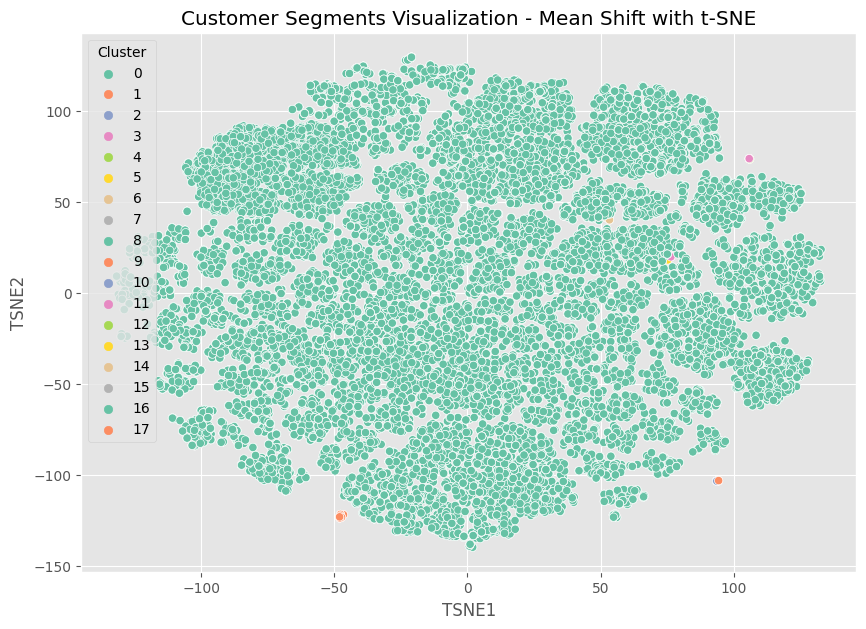

In [125]:
# t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_standardized[numeric_cols])
df_standardized['TSNE1'] = tsne_results[:, 0]
df_standardized['TSNE2'] = tsne_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Mean Shift with t-SNE')
plt.show()

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

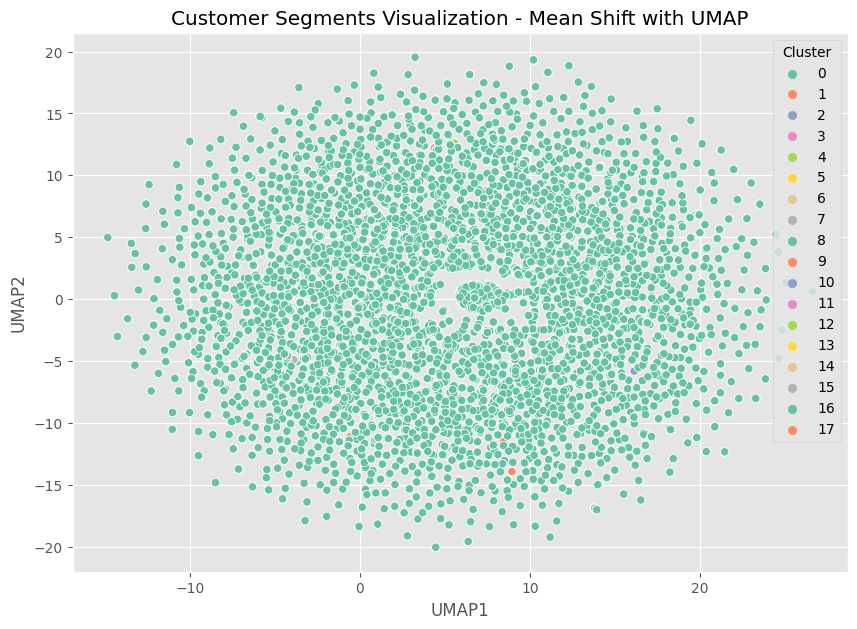

In [126]:
# UMAP
umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_results = umap_reducer.fit_transform(df_standardized[numeric_cols])
df_standardized['UMAP1'] = umap_results[:, 0]
df_standardized['UMAP2'] = umap_results[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Cluster', data=df_standardized, palette='Set2')
plt.title('Customer Segments Visualization - Mean Shift with UMAP')
plt.show()

# Inference

### DR first then clustering gave better cluster results and also was computationally less expensive (time taken to run)

# Splitting data on churn

In [127]:
# Split the dataset
churn_true = df[df['Churn'] == True]
churn_false = df[df['Churn'] == False]

churn_true_std = churn_true.copy()
churn_false_std = churn_false.copy()

# Standardize the split datasets
scaler = StandardScaler()
churn_true_std[numeric_cols] =scaler.fit_transform(churn_true[numeric_cols])
churn_false_std[numeric_cols] =scaler.fit_transform(churn_false[numeric_cols])

In [128]:
churn_true_std.head()

,Phone_Number,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn,Cluster
8,329-6603,-0.894530,-0.381186,-2.353534,-0.209938,-0.666921,-0.554338,-0.755232,-0.642230,-1.034167,-0.430601,-0.328387,-0.431756,0.308570,-0.180046,0.692848,1,1
12,351-7269,0.092737,-0.381186,1.551226,-1.004415,1.089635,1.582286,-0.595935,0.287112,-2.210183,-0.237635,-0.589000,-1.231073,0.991668,-1.016741,0.692848,1,2
17,393-7984,-0.771121,-0.381186,-3.631491,-0.754722,-1.241961,-1.956423,-0.322853,-1.251996,-1.014648,-0.964096,-0.324784,-1.198224,0.308570,-0.982764,1.142793,1,1
26,360-1596,-1.439583,-0.381186,-0.044783,-0.425582,0.371597,0.017502,-0.345610,-0.393671,0.707900,-0.668971,0.057129,-0.530302,-0.374528,-0.281978,-0.656987,1,1
39,398-1294,-0.339192,-0.381186,-1.778741,-0.470980,-0.408306,-0.487344,-0.368367,-0.612844,-2.634720,-0.657620,-0.683878,-0.858788,-0.374528,-0.626000,1.142793,1,1


In [129]:
churn_true.shape

(4153, 18)

In [130]:
churn_true.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn,Cluster
count,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.0,4153.000000
mean,151.982422,6.745967,251.937334,155.497231,35.101958,251.668505,149.374187,24.665134,251.186162,148.935228,12.134317,16.643142,4.644835,3.853919,2.460149,1.0,1.078979
std,97.249881,17.699462,52.198994,88.118811,19.722774,41.799930,87.896389,8.168051,40.990749,88.108880,8.327518,9.133902,4.392286,2.354785,2.222761,0.0,0.682159
min,1.000000,0.000000,62.400000,22.000000,9.890000,109.600000,20.000000,3.220000,123.500000,20.000000,2.020000,2.000000,1.000000,0.320000,0.000000,1.0,0.000000
25%,66.000000,0.000000,223.300000,88.000000,22.960000,222.800000,86.000000,22.220000,222.300000,82.000000,6.320000,8.900000,2.000000,2.280000,2.000000,1.0,1.000000
50%,130.000000,0.000000,243.200000,151.000000,28.620000,236.300000,111.000000,23.230000,236.200000,116.000000,9.240000,20.200000,3.000000,2.860000,2.000000,1.0,1.000000
75%,226.000000,0.000000,288.200000,222.000000,33.220000,286.000000,222.000000,28.620000,286.600000,222.000000,20.360000,22.600000,6.000000,3.920000,2.000000,1.0,2.000000
max,329.000000,88.000000,444.400000,329.000000,112.011000,404.200000,329.000000,211.211000,354.900000,329.000000,32.980000,32.900000,32.000000,8.920000,9.000000,1.0,2.000000


In [131]:
churn_false.shape

(31880, 18)

In [132]:
churn_false.describe()

,Account_Length,VMail_Message,Day_Mins,Day_Calls,Day_Charge,Eve_Mins,Eve_Calls,Eve_Charge,Night_Mins,Night_Calls,Night_Charge,Intl_Mins,Intl_Calls,Intl_Charge,CustServ_Calls,Churn,Cluster
count,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.000000,31880.0,31880.000000
mean,147.400063,11.798996,239.877796,148.242284,40.376714,249.758751,148.830207,24.332099,250.203466,148.110634,11.587733,15.500392,4.863519,3.683396,2.144730,0.0,1.103419
std,96.466295,22.624759,53.063296,86.103335,24.476160,40.319261,86.033175,6.753818,39.349735,85.750684,8.339034,10.059843,4.723023,2.281071,1.983259,0.0,0.659513
min,1.000000,0.000000,62.300000,20.000000,6.220000,109.600000,12.000000,2.110000,123.800000,20.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,62.000000,0.000000,222.200000,86.000000,23.240000,222.400000,87.000000,22.220000,222.400000,86.000000,4.440000,8.200000,2.000000,2.280000,2.000000,0.0,1.000000
50%,112.000000,0.000000,230.400000,110.000000,29.320000,234.400000,112.000000,23.220000,234.400000,111.000000,9.090000,20.000000,3.000000,2.820000,2.000000,0.0,1.000000
75%,224.000000,22.000000,282.800000,222.000000,42.940000,282.900000,222.000000,28.280000,286.200000,222.000000,20.280000,22.300000,8.000000,4.000000,2.000000,0.0,2.000000
max,329.000000,211.000000,444.400000,329.000000,211.990000,409.200000,329.000000,211.260000,381.900000,329.000000,211.220000,211.200000,211.000000,11.290000,11.000000,0.0,2.000000


# Comparing them together (side by side viz of clustering from earlier)

In [133]:
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN

def perform_clustering(data, title):
    # K-Means
    kmeans = KMeans(n_clusters=3, random_state=42, n_init='auto')
    kmeans_labels = kmeans.fit_predict(data)
    
    # DBSCAN
    dbscan = DBSCAN(eps=0.5, min_samples=5)
    dbscan_labels = dbscan.fit_predict(data)
    

    # Hierarchical Clustering
    hierarchical = AgglomerativeClustering(n_clusters=3)
    hierarchical_labels = hierarchical.fit_predict(data)
    
    # Mean Shift
    bandwidth = estimate_bandwidth(data, quantile=0.2)
    meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
    meanshift_labels = meanshift.fit_predict(data)

    
    # PCA
    pca = PCA(n_components=2)
    pca_results = pca.fit_transform(data)
    
    # t-SNE
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(data)
    
    # UMAP
    umap_reducer = umap.UMAP(n_components=2, random_state=42)
    umap_results = umap_reducer.fit_transform(data)
    
    # Visualization
    fig, axes = plt.subplots(4, 3, figsize=(20, 20))
    fig.suptitle(title, fontsize=16)
    
    # K-Means visualizations
    axes[0, 0].scatter(pca_results[:, 0], pca_results[:, 1], c=kmeans_labels, cmap='viridis')
    axes[0, 0].set_title('K-Means with PCA')
    axes[0, 1].scatter(tsne_results[:, 0], tsne_results[:, 1], c=kmeans_labels, cmap='viridis')
    axes[0, 1].set_title('K-Means with t-SNE')
    axes[0, 2].scatter(umap_results[:, 0], umap_results[:, 1], c=kmeans_labels, cmap='viridis')
    axes[0, 2].set_title('K-Means with UMAP')
    
    # DBSCAN visualizations
    axes[1, 0].scatter(pca_results[:, 0], pca_results[:, 1], c=dbscan_labels, cmap='viridis')
    axes[1, 0].set_title('DBSCAN with PCA')
    axes[1, 1].scatter(tsne_results[:, 0], tsne_results[:, 1], c=dbscan_labels, cmap='viridis')
    axes[1, 1].set_title('DBSCAN with t-SNE')
    axes[1, 2].scatter(umap_results[:, 0], umap_results[:, 1], c=dbscan_labels, cmap='viridis')
    axes[1, 2].set_title('DBSCAN with UMAP')
    
    # Hierarchical visualizations
    axes[2, 0].scatter(pca_results[:, 0], pca_results[:, 1], c=hierarchical_labels, cmap='viridis')
    axes[2, 0].set_title('Hierarchical with PCA')
    axes[2, 1].scatter(tsne_results[:, 0], tsne_results[:, 1], c=hierarchical_labels, cmap='viridis')
    axes[2, 1].set_title('Hierarchical with t-SNE')
    axes[2, 2].scatter(umap_results[:, 0], umap_results[:, 1], c=hierarchical_labels, cmap='viridis')
    axes[2, 2].set_title('Hierarchical with UMAP')

    # Meanshift visualizations
    axes[3, 0].scatter(pca_results[:, 0], pca_results[:, 1], c=meanshift_labels, cmap='viridis')
    axes[3, 0].set_title('Meanshift with PCA')
    axes[3, 1].scatter(tsne_results[:, 0], tsne_results[:, 1], c=meanshift_labels, cmap='viridis')
    axes[3, 1].set_title('Meanshift with t-SNE')
    axes[3, 2].scatter(umap_results[:, 0], umap_results[:, 1], c=meanshift_labels, cmap='viridis')
    axes[3, 2].set_title('Meanshift with UMAP')
    
    plt.tight_layout()
    plt.show()

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

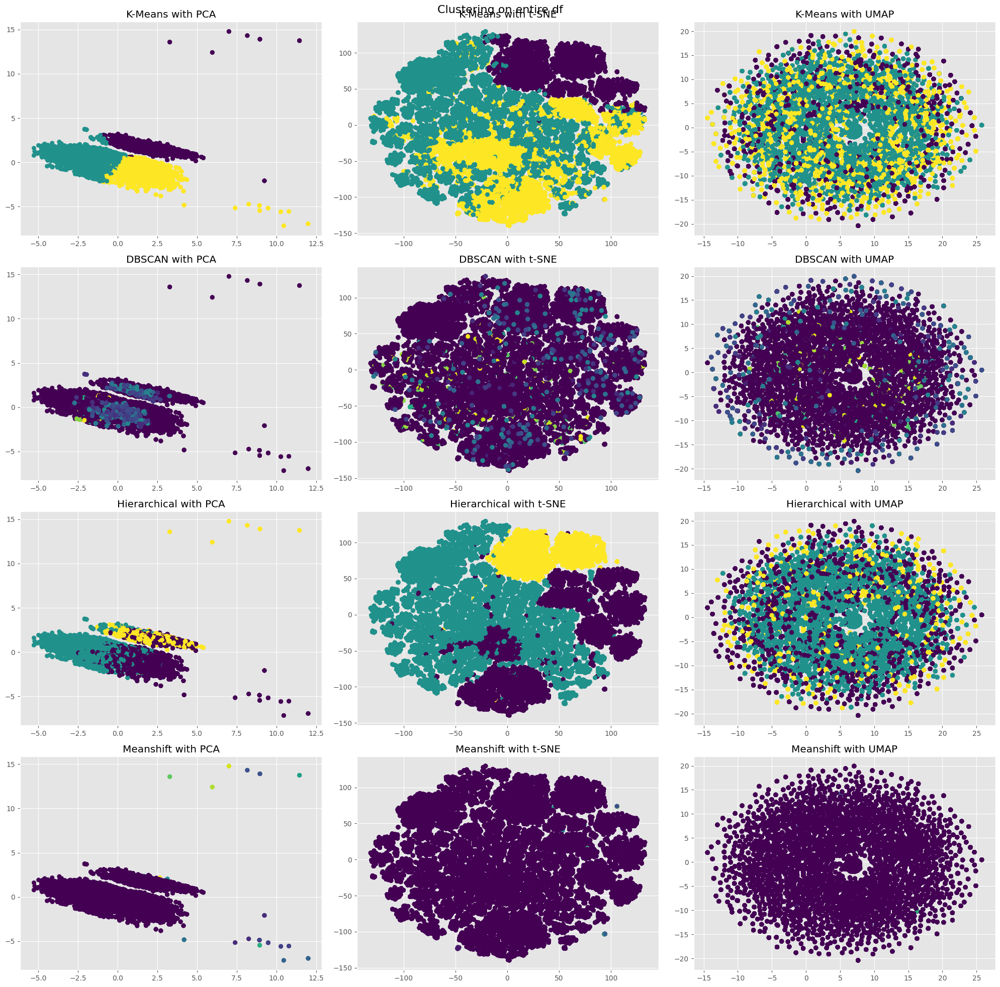

In [134]:
perform_clustering(df_standardized[numeric_cols], 'Clustering on entire df')

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

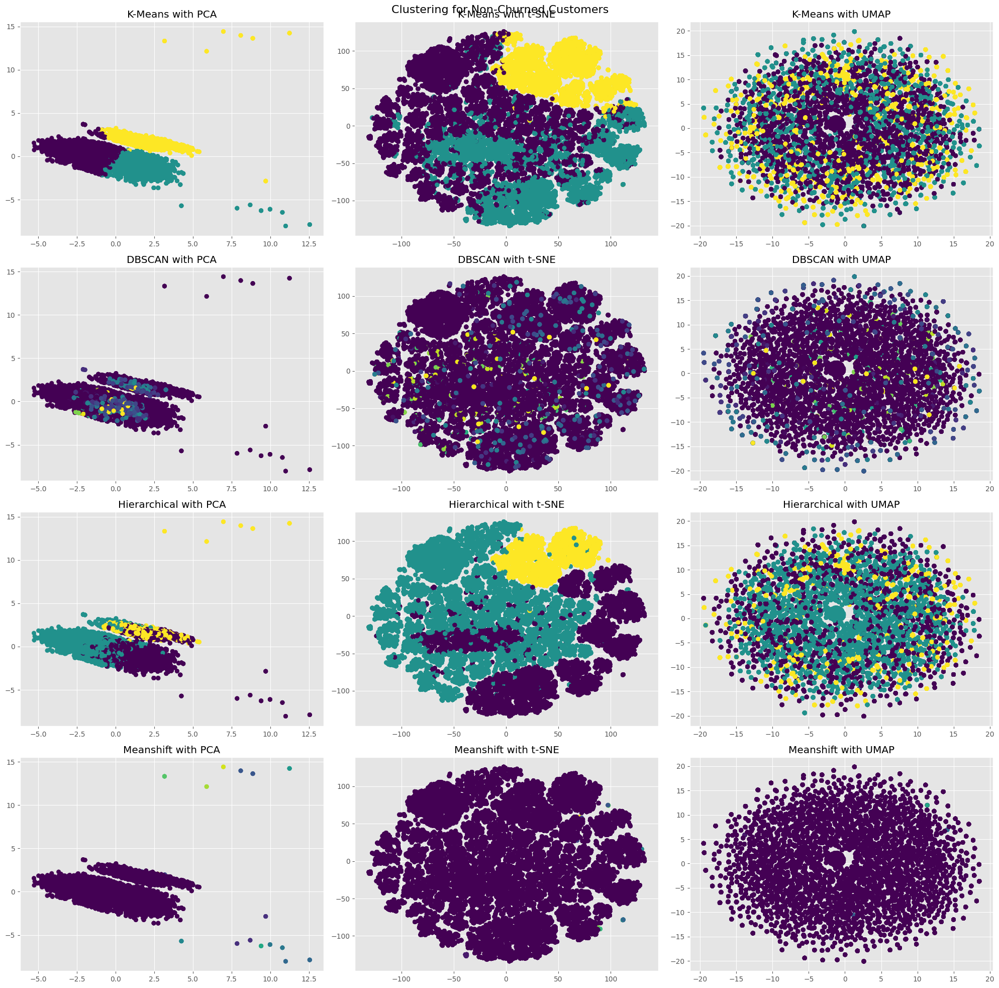

In [135]:
perform_clustering(churn_false_std[numeric_cols], 'Clustering for Non-Churned Customers')

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


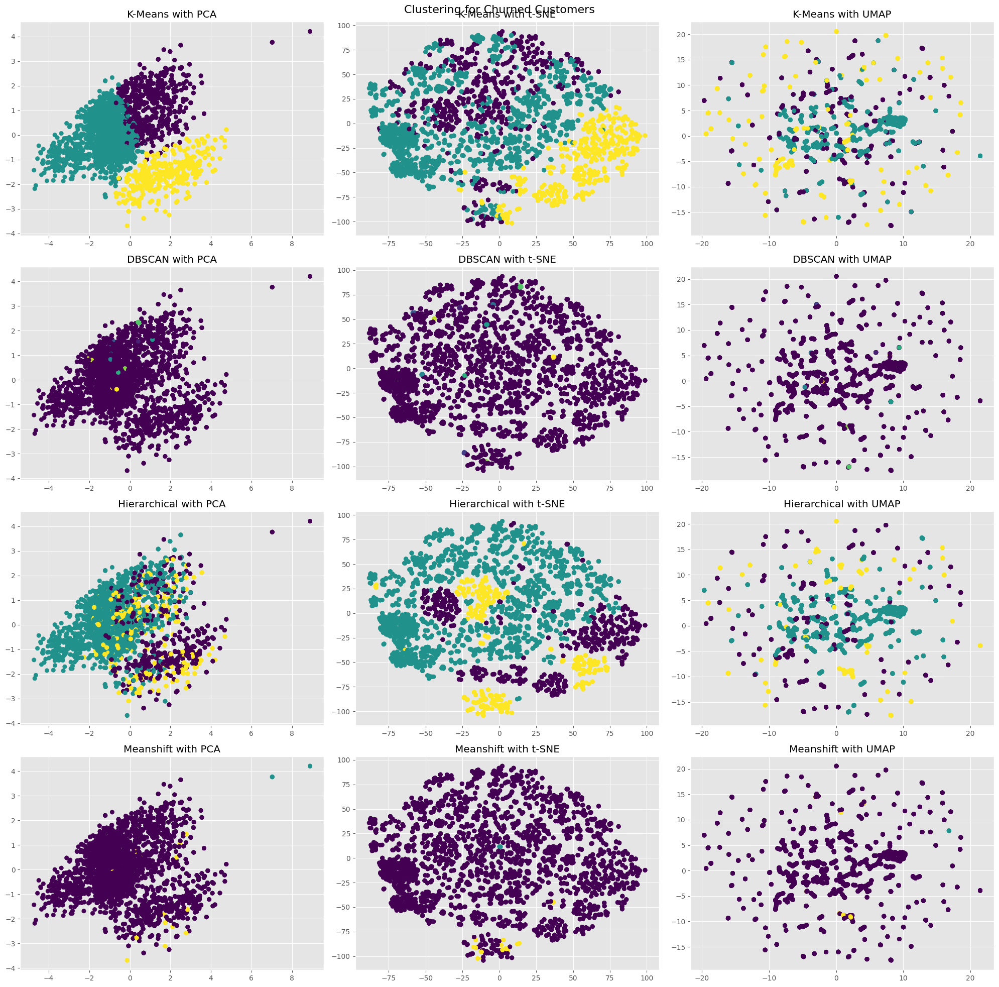

In [136]:
perform_clustering(churn_true_std[numeric_cols], 'Clustering for Churned Customers')

In [137]:
from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth, AgglomerativeClustering, DBSCAN
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import matplotlib.pyplot as plt

def perform_clustering(data, title):
    # Dimensionality Reduction
    pca = PCA(n_components=2)
    pca_results = pca.fit_transform(data)
    
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(data)
    
    umap_reducer = umap.UMAP(n_components=2, random_state=42)
    umap_results = umap_reducer.fit_transform(data)
    
    # List of reduced datasets
    reduced_datasets = [pca_results, tsne_results, umap_results]
    reduction_names = ['PCA', 't-SNE', 'UMAP']
    
    # Visualization setup
    fig, axes = plt.subplots(4, 3, figsize=(20, 20))
    fig.suptitle(title, fontsize=16)
    
    for i, (reduced_data, reduction_name) in enumerate(zip(reduced_datasets, reduction_names)):
        # K-Means
        kmeans = KMeans(n_clusters=3, random_state=42, n_init='auto')
        kmeans_labels = kmeans.fit_predict(reduced_data)
        
        # DBSCAN
        dbscan = DBSCAN(eps=0.5, min_samples=5)
        dbscan_labels = dbscan.fit_predict(reduced_data)
        
        # Hierarchical Clustering
        hierarchical = AgglomerativeClustering(n_clusters=3)
        hierarchical_labels = hierarchical.fit_predict(reduced_data)
        
        # Mean Shift
        bandwidth = estimate_bandwidth(reduced_data, quantile=0.2)
        meanshift = MeanShift(bandwidth=bandwidth, bin_seeding=True)
        meanshift_labels = meanshift.fit_predict(reduced_data)
        
        # Visualizations
        axes[0, i].scatter(reduced_data[:, 0], reduced_data[:, 1], c=kmeans_labels, cmap='viridis')
        axes[0, i].set_title(f'K-Means with {reduction_name}')
        
        axes[1, i].scatter(reduced_data[:, 0], reduced_data[:, 1], c=dbscan_labels, cmap='viridis')
        axes[1, i].set_title(f'DBSCAN with {reduction_name}')
        
        axes[2, i].scatter(reduced_data[:, 0], reduced_data[:, 1], c=hierarchical_labels, cmap='viridis')
        axes[2, i].set_title(f'Hierarchical with {reduction_name}')
        
        axes[3, i].scatter(reduced_data[:, 0], reduced_data[:, 1], c=meanshift_labels, cmap='viridis')
        axes[3, i].set_title(f'Meanshift with {reduction_name}')
    
    plt.tight_layout()
    plt.show()

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

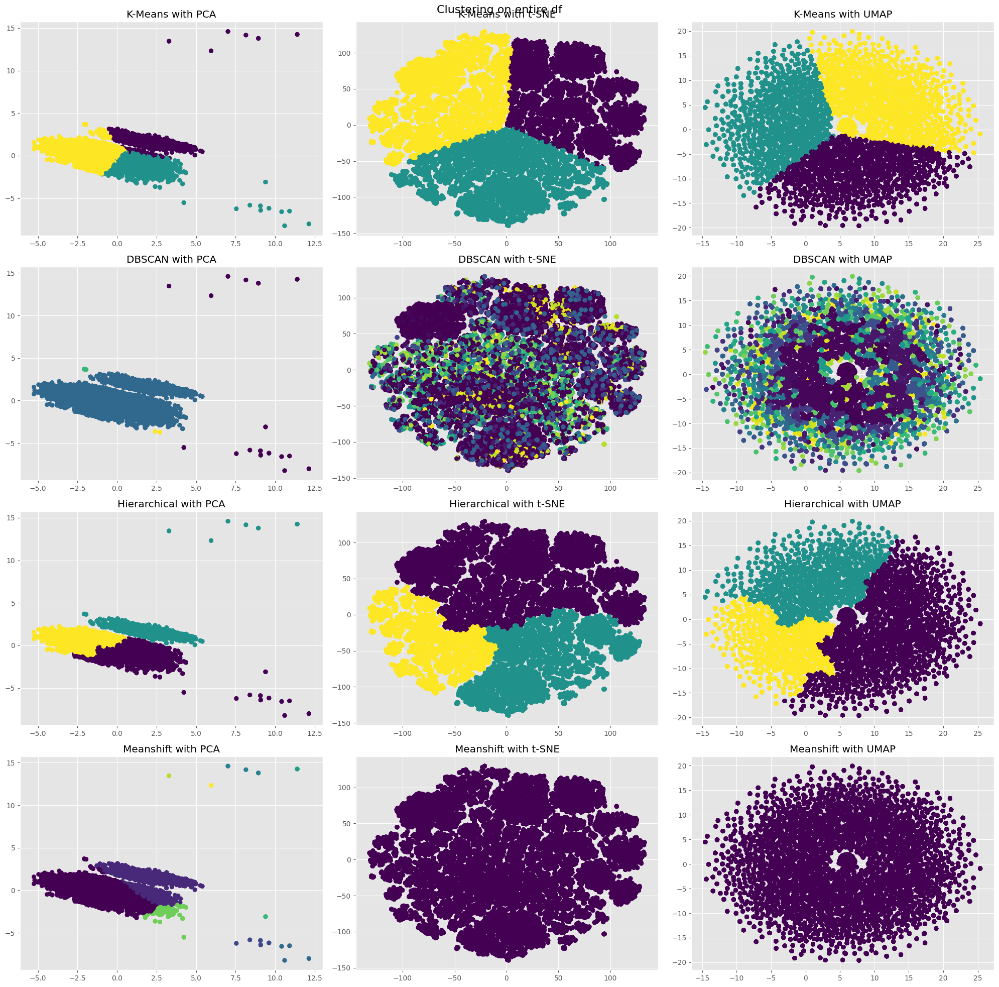

In [138]:
perform_clustering(df_standardized[numeric_cols], 'Clustering on entire df')

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/opt/conda/lib/python3.10/site-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small 

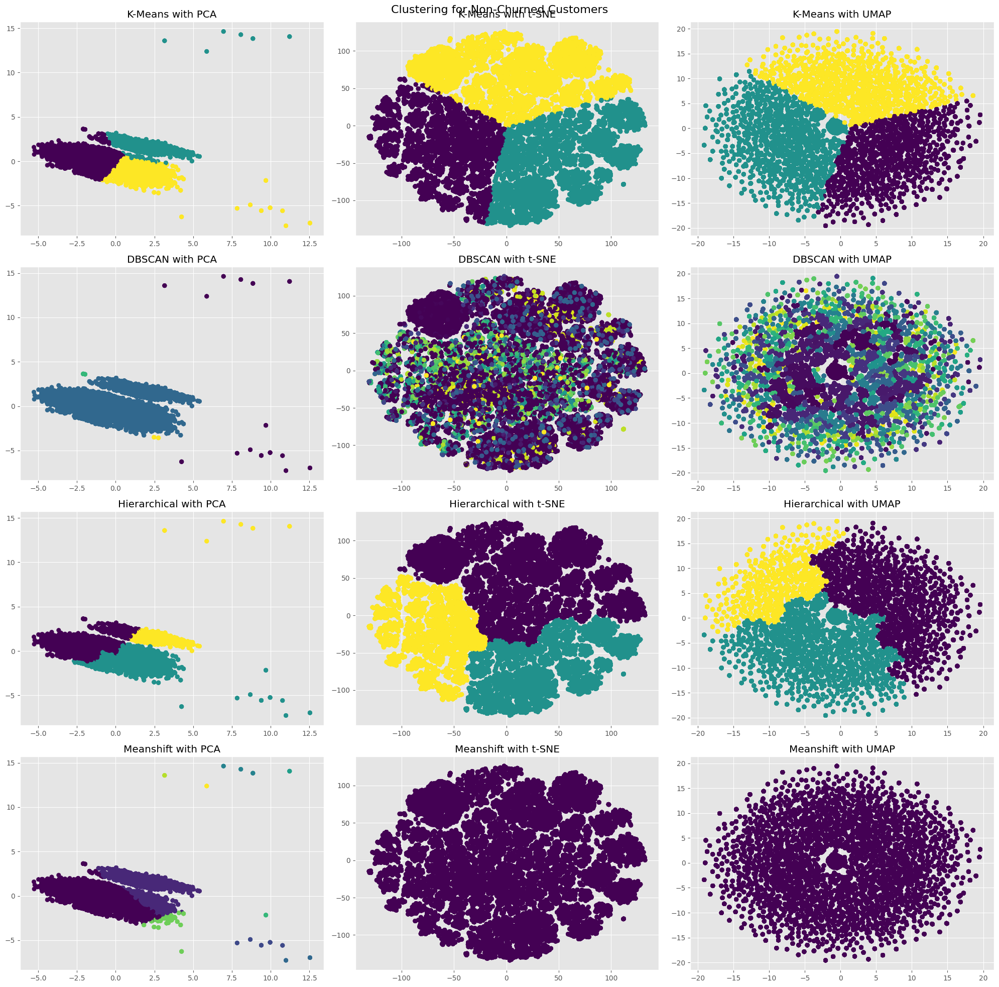

In [139]:
perform_clustering(churn_false_std[numeric_cols], 'Clustering for Non-Churned Customers')

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


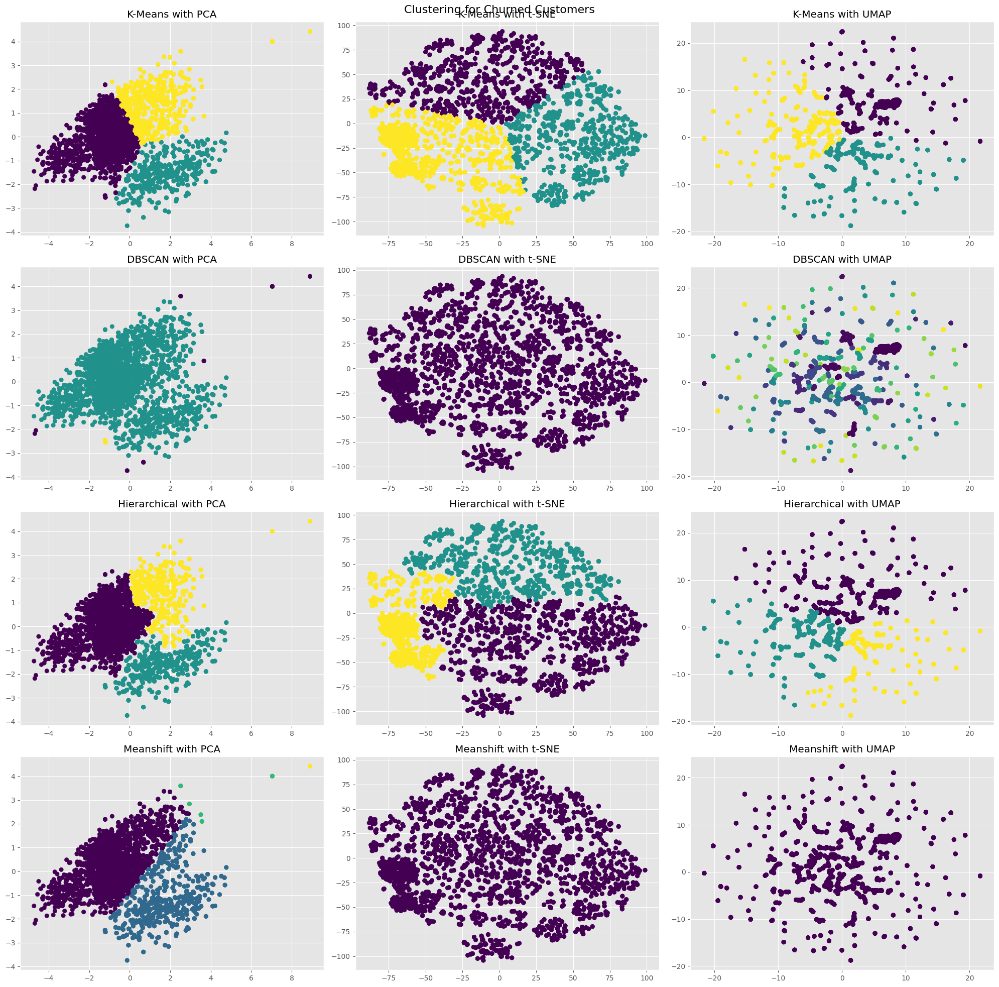

In [140]:
perform_clustering(churn_true_std[numeric_cols], 'Clustering for Churned Customers')